## Proyecto de curso Análisis Big Data
### Entrega Final

### Magister en Data Science, Universidad del Desarrollo
##### Grupo: Jesus Berrios, Cesar Marin, Jorge Adrian Fernandez

## Parte 1: Recolección de datos

Se instalan e importan las librerías a utilizar para el desarrollo del proyecto

In [0]:
pip install geopandas

Python interpreter will be restarted.
Collecting geopandas
 Downloading geopandas-0.9.0-py2.py3-none-any.whl (994 kB)
Collecting fiona>=1.8
 Downloading Fiona-1.8.20-cp38-cp38-manylinux_2_5_x86_64.manylinux1_x86_64.whl (15.4 MB)
Collecting pyproj>=2.2.0
 Downloading pyproj-3.1.0-cp38-cp38-manylinux2010_x86_64.whl (6.6 MB)
Collecting shapely>=1.6
 Downloading Shapely-1.7.1-cp38-cp38-manylinux1_x86_64.whl (1.0 MB)
Requirement already satisfied: pandas>=0.24.0 in /local_disk0/.ephemeral_nfs/envs/pythonEnv-c2664838-c193-47a3-bf07-50409ef47e9b/lib/python3.8/site-packages (from geopandas) (1.1.5)
Collecting click-plugins>=1.0
 Downloading click_plugins-1.1.1-py2.py3-none-any.whl (7.5 kB)
Requirement already satisfied: setuptools in /local_disk0/.ephemeral_nfs/envs/pythonEnv-c2664838-c193-47a3-bf07-50409ef47e9b/lib/python3.8/site-packages (from fiona>=1.8->geopandas) (50.3.1.post20201107)
Requirement already satisfied: six>=1.7 in /local_disk0/.ephemeral_nfs/envs/pythonEnv-c2664838-c193-47a3-bf07-50409ef47e9b/lib/python3.8/site-packages (from fiona>=1.8->geopandas) (1.15.0)
Requirement already satisfied: certifi in /local_disk0/.ephemeral_nfs/envs/pythonEnv-c2664838-c193-47a3-bf07-50409ef47e9b/lib/python3.8/site-packages (from fiona>=1.8->geopandas) (2020.12.5)
Collecting cligj>=0.5
 Downloading cligj-0.7.2-py3-none-any.whl (7.1 kB)
Requirement already satisfied: click>=4.0 in /local_disk0/.ephemeral_nfs/envs/pythonEnv-c2664838-c193-47a3-bf07-50409ef47e9b/lib/python3.8/site-packages (from fiona>=1.8->geopandas) (7.1.2)
Collecting munch
 Downloading munch-2.5.0-py2.py3-none-any.whl (10 kB)
Requirement already satisfied: attrs>=17 in /local_disk0/.ephemeral_nfs/envs/pythonEnv-c2664838-c193-47a3-bf07-50409ef47e9b/lib/python3.8/site-packages (from fiona>=1.8->geopandas) (20.3.0)
Requirement already satisfied: python-dateutil>=2.7.3 in /local_disk0/.ephemeral_nfs/envs/pythonEnv-c2664838-c193-47a3-bf07-50409ef47e9b/lib/python3.8/site-packages (from pandas>=0.24.0->geopandas) (2.8.1)
Requirement already satisfied: pytz>=2017.2 in /local_disk0/.ephemeral_nfs/envs/pythonEnv-c2664838-c193-47a3-bf07-50409ef47e9b/lib/python3.8/site-packages (from pandas>=0.24.0->geopandas) (2020.5)
Requirement already satisfied: numpy>=1.15.4 in /local_disk0/.ephemeral_nfs/envs/pythonEnv-c2664838-c193-47a3-bf07-50409ef47e9b/lib/python3.8/site-packages (from pandas>=0.24.0->geopandas) (1.19.2)
Installing collected packages: click-plugins, cligj, munch, fiona, pyproj, shapely, geopandas
Successfully installed click-plugins-1.1.1 cligj-0.7.2 fiona-1.8.20 geopandas-0.9.0 munch-2.5.0 pyproj-3.1.0 shapely-1.7.1
Python interpreter will be restarted.

In [0]:
pip install rtree

Python interpreter will be restarted.
Collecting rtree
 Downloading Rtree-0.9.7-cp38-cp38-manylinux2010_x86_64.whl (994 kB)
Installing collected packages: rtree
Successfully installed rtree-0.9.7
Python interpreter will be restarted.

In [0]:
import pyspark
import geopandas as gpd
import matplotlib.pyplot as plt
import os
from pyspark import SparkConf, SparkContext
from pyspark.sql import HiveContext, SparkSession
from pyspark.sql.functions import col,desc,udf,substring,regexp_replace,row_number
from pyspark.sql.window import Window
from pyspark.sql.types import StringType
from pyspark.sql.functions import lit,monotonically_increasing_id
from pyspark.sql import functions as F, types as T
from pyspark.sql.types import DoubleType, FloatType
import rtree
import numpy as np
import pandas as pd

In [0]:
#Se verifica el directorio en donde están alojados los archivos
os.listdir('/dbfs/FileStore/tables/')

Out[2]: ['2017wifi.csv',
 '2017wifi_csv.zip',
 '2018wifi.csv',
 '2018wifi_csv.zip',
 '2019wifi.csv',
 '2019wifi_csv.zip',
 'Atropellos_Santiago.zip',
 'Manzana_Precensal.shp',
 'Microdatos_Censo_2017%3A_Manzana.cpg',
 'Microdatos_Censo_2017%3A_Manzana.dbf',
 'Microdatos_Censo_2017%3A_Manzana.prj',
 'Microdatos_Censo_2017%3A_Manzana.shp',
 'Microdatos_Censo_2017%3A_Manzana.shx',
 'Microdatos_Censo_2017%3A_Manzana.xml',
 'Microdatos_Censo_2017.zip',
 'R13',
 'R13.zip',
 'Region.shp',
 '__MACOSX',
 'data_merged.csv',
 'data_merged2.csv',
 'df_sprint2.csv',
 'df_sprint2_jesus.csv',
 'df_sprint3.csv',
 'estaciones_metro.xlsx',
 'mac_db_cleaned.csv',
 'metros.csv',
 'microdatos.csv',
 'oui_cleaned.csv',
 'retail',
 'retail.csv',
 'retail_manzana.csv',
 'retails.xlsx',
 'sprint2.csv',
 'zonas_censales']

Se recolectan los datos y se muestran algunos valores de los datos colectados y cantidad de registros

In [0]:
#Se inicializa sesión Spark
spark = SparkSession.builder.appName("Sprint3").getOrCreate()

#Se recolectan datos wifi para los tres datasets pedidos
df2017 = spark.read.options(header='true').csv("/FileStore/tables/2017wifi.csv")
df2018 = spark.read.options(header='true').csv("/FileStore/tables/2018wifi.csv")
df2019 = spark.read.options(header='true').csv("/FileStore/tables/2019wifi.csv")

print('df2017')
for i in df2017.head(3):
  print(i)
  
print('\ndf2018')
for i in df2018.head(3):
  print(i)

print('\ndf2019')
for i in df2019.head(3):
  print(i)

print(f'\n\ncount df 2017={df2017.count()}')
print(f'count df 2018={df2018.count()}')
print(f'count df 2019={df2019.count()}')

df2017
Row(id='1', data_source='0', bssid='0001E3C290F9', lat='45.22128388', lon='16.54838246', range='139.01', updated='1428513555', created='1428513555')
Row(id='2', data_source='0', bssid='000C421F65E9', lat='45.22027969', lon='16.54707052', range='140.00', updated='1428513555', created='1428513555')
Row(id='3', data_source='0', bssid='000C422377FC', lat='45.20828617', lon='16.90385474', range='140.00', updated='1428513555', created='1428513555')

df2018
Row(id='1', data_source='0', bssid='0001E3C290F9', lat='45.22128388', lon='16.54838246', range='139.01', created='1428513555', updated='1428513555')
Row(id='2', data_source='0', bssid='000C421F65E9', lat='45.22027969', lon='16.54707052', range='140.00', created='1428513555', updated='1428513555')
Row(id='3', data_source='0', bssid='000C422377FC', lat='45.20828617', lon='16.90385474', range='140.00', created='1428513555', updated='1428513555')

df2019
Row(id='1', bssid='0001E3C290F9', lat='45.22128388', lon='16.54838246', updated='1428513555', data='0')
Row(id='2', bssid='000C421F65E9', lat='45.22027969', lon='16.54707052', updated='1428513555', data='0')
Row(id='3', bssid='000C422377FC', lat='45.20828617', lon='16.90385474', updated='1428513555', data='0')


count df 2017=37841214
count df 2018=37841214
count df 2019=37841214

Se genera un DataFrame con todos los input:

In [0]:
#Se genera un solo dataframe con todos los input
df = df2017.select('bssid','lat','lon','updated').union(df2018.select('bssid','lat','lon','updated')).union(df2019.select('bssid','lat','lon','updated'))
print(f'count = {df.count()}')
display(df)

count = 113523642

bssid,lat,lon,updated
0001E3C290F9,45.22128388,16.54838246,1428513555
000C421F65E9,45.22027969,16.54707052,1428513555
000C422377FC,45.20828617,16.90385474,1428513555
000C422377F4,45.20799464,16.90336159,1428513555
000C422377C5,45.17570261,16.81720250,1428513555
000C42630AED,45.18732229,16.83431923,1428513555
000C42630AEC,45.18054666,16.81053529,1428513555
0005595C556A,45.18191138,16.80946429,1428513555
000C421BB4FE,45.20791481,16.90272641,1428513555
000C422CC930,45.19232675,16.84438858,1428513555


De acuerdo a la exploración de los datos se definió como columna temporal a tomar en cuenta el campo "updated". Dicho campo se encuentra originalmente en formato fecha Unix, por lo que se aplicó la transformación a dicha columna para obtener el año como granularidad temporal. Finalmente, la granularidad temporal no será utilizada.

In [0]:
df = df.withColumn('year',F.from_unixtime(df.updated,'yyyy'))
display(df)

bssid,lat,lon,updated,year
0001E3C290F9,45.22128388,16.54838246,1428513555,2015
000C421F65E9,45.22027969,16.54707052,1428513555,2015
000C422377FC,45.20828617,16.90385474,1428513555,2015
000C422377F4,45.20799464,16.90336159,1428513555,2015
000C422377C5,45.17570261,16.81720250,1428513555,2015
000C42630AED,45.18732229,16.83431923,1428513555,2015
000C42630AEC,45.18054666,16.81053529,1428513555,2015
0005595C556A,45.18191138,16.80946429,1428513555,2015
000C421BB4FE,45.20791481,16.90272641,1428513555,2015
000C422CC930,45.19232675,16.84438858,1428513555,2015


Se eliminan los datos duplicados considerando las columnas: bssid, lat, lon, updated, year. Se ejecuta un filtro inicial por polígono rectangular que cubra la zona geográfica de Chile de manera de aligerar los datos fuente para luego ejecutar las correlaciones con las demarcaciones geográficas

In [0]:
df = df.dropDuplicates(['bssid','lat','lon'])
print(f'count despues de eliminar duplicados={df.count()}')

#Se filtra aproximación para datos de Chile por polígono rectangular con límites de Latitud y Longitud
df = df.filter( (df.lat>=-56.53) & (df.lat<=-17.483) &\
           (df.lon>=-109.633) & (df.lon<=-68.6))

display(df)

#Cantidad de datos resultante
print(f'Cantidad de datos resultante ={df.count()}')

count despues de eliminar duplicados=23350658

bssid,lat,lon,updated,year
0004EDD91078,-32.95229071,-71.54710153,1468656137,2016
000726152B9D,-36.61813746,-72.11833422,1444444147,2015
00082F33CC00,-22.49481709,-68.90764052,1428513555,2015
000AC28E8902,-34.15859326,-70.70894726,1428513555,2015
00119552A859,-32.92810483,-71.51523284,1428513555,2015
00147F25A712,-33.04610000,-71.61471000,1428513555,2015
00147F25B4E3,-33.45820000,-70.62090000,1428513555,2015
00147F25B97E,-36.79162000,-73.06639000,1428513555,2015
00147F25B9F6,-33.39701000,-70.79328000,1428513555,2015
00147F25BD7A,-53.16605978,-70.91063615,1428513555,2015


Cantidad de datos resultante =52064

Generación de puntos en GeoDataFrame

In [0]:
df_pandas = df.toPandas()
gdf_wifi = gpd.GeoDataFrame(
    df_pandas, geometry=gpd.points_from_xy(df_pandas.lon, df_pandas.lat), crs=4674)

#Dataframe resultante a correlacionar con zonas geográficas
gdf_wifi

Out[7]:

,bssid,lat,lon,updated,year,geometry
0,0004EDD91078,-32.95229071,-71.54710153,1468656137,2016,POINT (-71.54710 -32.95229)
1,000726152B9D,-36.61813746,-72.11833422,1444444147,2015,POINT (-72.11833 -36.61814)
2,00082F33CC00,-22.49481709,-68.90764052,1428513555,2015,POINT (-68.90764 -22.49482)
3,000AC28E8902,-34.15859326,-70.70894726,1428513555,2015,POINT (-70.70895 -34.15859)
4,00119552A859,-32.92810483,-71.51523284,1428513555,2015,POINT (-71.51523 -32.92810)
...,...,...,...,...,...,...
52059,FCB4E6561C57,-33.03735952,-71.59815827,1428513555,2015,POINT (-71.59816 -33.03736)
52060,FCB4E6729A1B,-33.05151172,-71.60749991,1428513555,2015,POINT (-71.60750 -33.05151)
52061,FCB4E6920238,-33.01768017,-71.55557334,1428513555,2015,POINT (-71.55557 -33.01768)
52062,FCB4E6923988,-33.01911894,-71.55832458,1468686700,2016,POINT (-71.55832 -33.01912)


**Recolección de identificación de proveedores por octetos de MAC Address:** Se utilizaron datos de la fuente https://gitlab.com/wireshark/wireshark/raw/master/manuf.txt, los cuales permitieron tener mayor precisión de identificación de proveedores de acuerdo a la dirección MAC con respecto al archivo original propuesto.

In [0]:
#Se genera dataframe con mapeo OUI/Fabricante
df_oui = spark.read.options(header='false',sep=';',columns=['A','B']).csv("/FileStore/tables/mac_db_cleaned.csv")
df_oui = df_oui.select(col("_c0").alias("oui"), col("_c1").alias("provider"))
df_oui = df_oui.withColumn('d1', regexp_replace(col("provider"), "[.+\t]", ""))
df_oui = df_oui.select(col("oui"), col("d1").alias("provider"))
display(df_oui)

oui,provider
000000,000000
000001,Xerox
000002,Xerox
000003,Xerox
000004,Xerox
000005,Xerox
000006,Xerox
000007,Xerox
000008,Xerox
000009,Powerpip


**Recolección de ubicaciones geográficas:** Se recolectan los datos en un GeoDataFrame a partir de los archivos .shp

In [0]:
#Se genera lista con archivos shp con manzanas precensales
files_list = []

for i in os.listdir('/dbfs/FileStore/tables/zonas_censales/'):
  for j in os.listdir(f'/dbfs/FileStore/tables/zonas_censales/{i}/'):
    if 'Manzana_Precensal.shp' in j:
      files_list.append(f'/dbfs/FileStore/tables/zonas_censales/{i}/{j}')

files_list

Out[9]: ['/dbfs/FileStore/tables/zonas_censales/R01/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R02/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R03/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R04/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R05/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R06/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R07/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R08/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R09/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R10/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R11/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R12/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R13/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R14/Manzana_Precensal.shp',
 '/dbfs/FileStore/tables/zonas_censales/R15/Manzana_Precensal.shp']

In [0]:
#Leer shapefiles de todas las regiones y guardarlo en un GeoDataFrame
for i,j in enumerate(files_list):
  if i==0:
    gdf  = gpd.GeoDataFrame(gpd.read_file(j), geometry='geometry')
  else:
    gdf = gdf.append(gpd.GeoDataFrame(gpd.read_file(j), geometry='geometry'))
display(gdf)

,REGION,PROVINCIA,COMUNA,COD_DIS,COD_ZON,COD_ENT,MANZENT,DES_REGI,DES_PROV,DES_COMU,geometry
0,1,11,1107,1,2,2,1107011002002,REGIÓN DE TARAPACÁ,IQUIQUE,ALTO HOSPICIO,"POLYGON ((-70.10153 -20.24636, -70.10136 -20.2..."
1,1,11,1107,1,2,14,1107011002014,REGIÓN DE TARAPACÁ,IQUIQUE,ALTO HOSPICIO,"POLYGON ((-70.09675 -20.24366, -70.09784 -20.2..."
2,1,11,1107,1,2,19,1107011002019,REGIÓN DE TARAPACÁ,IQUIQUE,ALTO HOSPICIO,"POLYGON ((-70.09625 -20.24406, -70.09658 -20.2..."
3,1,11,1107,1,2,20,1107011002020,REGIÓN DE TARAPACÁ,IQUIQUE,ALTO HOSPICIO,"POLYGON ((-70.09613 -20.24365, -70.09603 -20.2..."
4,1,11,1107,1,2,15,1107011002015,REGIÓN DE TARAPACÁ,IQUIQUE,ALTO HOSPICIO,"POLYGON ((-70.09672 -20.24369, -70.09669 -20.2..."
...,...,...,...,...,...,...,...,...,...,...,...
2813,15,151,15101,19,3,501,15101191003501,REGIÓN DE ARICA Y PARINACOTA,ARICA,ARICA,"POLYGON ((-70.27474 -18.48643, -70.27475 -18.4..."
2814,15,151,15101,19,2,1,15101191002001,REGIÓN DE ARICA Y PARINACOTA,ARICA,ARICA,"POLYGON ((-70.27277 -18.47915, -70.27225 -18.4..."
2815,15,152,15201,1,1,501,15201011001501,REGIÓN DE ARICA Y PARINACOTA,PARINACOTA,PUTRE,"POLYGON ((-69.56109 -18.19658, -69.56110 -18.1..."
2816,15,152,15201,1,1,500,15201011001500,REGIÓN DE ARICA Y PARINACOTA,PARINACOTA,PUTRE,"POLYGON ((-69.56103 -18.19562, -69.56104 -18.1..."


**Se obtienen los Microdatos por Manzana en un DataFrame Pyspark**

In [0]:
#Obtención de microdatos a partir de archivo .shp, se guarda en .csv
gdf_md  = gpd.GeoDataFrame(gpd.read_file('/dbfs/FileStore/tables/Microdatos_Censo_2017%3A_Manzana.shp'), geometry='geometry')
gdf_md.to_csv('/dbfs/FileStore/tables/microdatos.csv')

#Se lee .csv guardado en un pyspark DataFrame
dfrmicrod = spark.read.options(header='true').csv("dbfs:/FileStore/tables/microdatos.csv")
display(dfrmicrod)

_c0,FID,CUT,REGION,PROVINCIA,COMUNA,Shape__Are,Shape__Len,NOMBRE_DIS,CODIGO_DIS,MANZENT,ZONA_CENSA,MANZANA,TOTAL_PERS,TOTAL_HOMB,TOTAL_MUJE,PERSONAS_0,PERSONAS_6,PERSONAS_1,PERSONAS_M,PERSONAS_E,PUEBLOS_IN,TOTAL_VIV_,TOTAL_VI_1,VIV_OCUPA_,TOTAL_VIVI,CANTIDAD_H,VIV_TIPO_C,VIV_TIPO_D,VIV_TIPO_T,VIV_TIPO_P,VIV_TIPO_M,VIV_TIPO_1,VIV_TIPO_O,VIV_PARED_,VIV_PARE_1,VIV_PARE_2,VIV_PARE_3,VIV_PARE_4,VIV_PARE_5,VIV_TECHO_,VIV_TECH_1,VIV_TECH_2,VIV_TECH_3,VIV_TECH_4,VIV_TECH_5,VIV_TECH_6,VIV_PISO_P,VIV_PISO_R,VIV_PISO_B,VIV_PISO_C,VIV_PISO_T,VIV_MATERI,VIV_MATE_1,VIV_MATE_2,VIV_AGUA_R,VIV_AGUA_P,VIV_AGUA_C,VIV_AGUA_1,geometry
0,1,13101,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,SANTIAGO,14688.97265625,1045.70138095235,MATADERO,21,13101211002011,2,11,189,90,99,9,14,142,24,15,14,100,0,83,100,83,4,89,0,7,0,0,0,74,9,0,0,0,0,34,38,11,0,0,0,0,83,0,0,0,0,83,0,0,82,0,0,0,"POLYGON ((-7864555.5263201 -3958306.39649223, -7864550.10060812 -3958424.1447584, -7864539.38577318 -3958433.5466817, -7864536.9974135 -3958436.97261368, -7864536.82030419 -3958438.50588238, -7864536.86349615 -3958439.60568818, -7864536.90390513 -3958440.62395283, -7864537.1121839 -3958441.79635857, -7864537.46885154 -3958442.59815872, -7864538.32634558 -3958443.74720997, -7864539.05248262 -3958444.65657533, -7864539.475608 -3958445.08857062, -7864540.61206868 -3958446.10403319, -7864599.25818206 -3958449.84198785, -7864599.27109512 -3958436.15600037, -7864566.9479225 -3958433.80798723, -7864567.07716443 -3958432.00754163, -7864567.20629503 -3958430.20963197, -7864599.33332272 -3958432.53856028, -7864599.54360524 -3958425.91063786, -7864575.29899937 -3958424.05787905, -7864575.13502576 -3958424.04546772, -7864575.0746906 -3958424.0425317, -7864574.98674821 -3958424.03345675, -7864570.31244279 -3958423.51725202, -7864570.50847641 -3958421.72281351, -7864570.70428739 -3958419.93104439, -7864573.5360326 -3958420.24132764, -7864574.79305229 -3958380.05004024, -7864576.58885832 -3958380.10422285, -7864578.38455302 -3958380.16334329, -7864577.12074284 -3958420.57936957, -7864599.62297603 -3958422.29386824, -7864600.17612258 -3958380.27971579, -7864601.97259653 -3958380.30106854, -7864603.76907047 -3958380.32749257, -7864603.21358621 -3958422.5292832, -7864625.5399346 -3958423.72757742, -7864625.86932898 -3958383.48943529, -7864627.66591423 -3958383.50184658, -7864629.4624995 -3958383.51906224, -7864629.13265985 -3958423.79657376, -7864631.85831758 -3958423.75546956, -7864631.88692669 -3958425.55778224, -7864631.91542447 -3958427.36276431, -7864627.34954425 -3958427.43563087, -7864627.22531169 -3958427.43069302, -7864627.03662516 -3958427.42308608, -7864603.13143243 -3958426.14244959, -7864602.92059331 -3958432.78491878, -7864631.08776406 -3958434.60524934, -7864630.97288235 -3958436.40422732, -7864630.85766668 -3958438.20560779, -7864602.86415433 -3958436.40129131, -7864602.85135259 -3958450.0709975, -7864641.55847537 -3958452.53805629, -7864644.63078199 -3958452.41594447, -7864646.33897958 -3958451.6298914, -7864648.0416112 -3958450.70024024, -7864648.80915908 -3958449.80782324, -7864649.9327067 -3958447.75234173, -7864650.52080757 -3958445.71994838, -7864653.33607749 -3958425.54403635, -7864666.08872704 -3958317.53749193, -7864666.04431056 -3958315.37700567, -7864665.73517634 -3958313.470883, -7864664.75979496 -3958311.63175451, -7864663.41683662 -3958310.36861331, -7864661.92593468 -3958309.50076266, -7864660.16842256 -3958308.57312473, -7864657.10624601 -3958307.80269554, -7864565.64103167 -3958301.34072767, -7864564.99226168 -3958301.36661771, -7864562.51929919 -3958301.46497315, -7864560.3364353 -3958301.71506556, -7864558.48218654 -3958302.37526151, -7864557.73000074 -3958302.98421124, -7864556.69651059 -3958304.14459218, -7864555.98651488 -3958305.1608431, -7864555.5263201 -3958306.39649223))"
1,2,13102,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,CERRILLOS,4117.6953125,267.65298582278,DIVINO MAESTRO,3,13102031005035,5,35,80,39,41,8,7,51,14,Indeterminado,5,20,0,20,20,23,20,0,0,0,0

**Se obtienen los datos de retails**

In [0]:
#Se lee archivo .csv alojado en el servidor
retails_csv = spark.read.options(header='true',sep=';').csv("dbfs:/FileStore/tables/retail.csv")
display(retails_csv)

CODIGO,ENTIDAD,NOMBRE FANTASIA,DIRECCION,COMUNA,HORARIO REFERENCIAL,ESTE,NORTE,LONGITUD,LATITUD
102,UNIMARC,UNIMARC JUAN ANTONIO RIOS,SALOMON SACK 351,INDEPENDENCIA,Lun-Dom 09:00 a 20:00,344653,6300937,-70.67080616666668,-33.419566666666654
103,UNIMARC,UNIMARC DORSAL,AV. EL GUANACO 3100,CONCHALI,Lun-Dom 09:00 a 20:00,345812,6303726,-70.6578679616206,-33.3945915377861
104,UNIMARC,UNIMARC LO OVALLE,GRAN AVENIDA JOSE MIGUEL CARRERA 6555,LA CISTERNA,Lun-Dom 09:00 a 20:00,345864,6290169,-70.65963511904762,-33.516832083333334
105,UNIMARC,UNIMARC VICUÑA PARAD 19,AV. VICUÑA MACKENNA 9090,LA FLORIDA,Lun-Dom 09:00 a 20:00,352240,6287757,-70.5914099988768,-33.5394802038029
106,UNIMARC,UNIMARC ROJAS MAGALLANES,AV. ROJAS MAGALLANES 3638,LA FLORIDA,Lun-Dom 09:00 a 20:00,355705,6288235,-70.5547798666583,-33.5359270019668
107,UNIMARC,UNIMARC MIRADOR,AV. VICUÑA MACKENNA ORIENTE 6331,LA FLORIDA,Lun-Dom 09:00 a 20:00,350733,6290567,-70.6071683333333,-33.513935000000004
108,UNIMARC,UNIMARC VICENTE VALDES,VICENTE VALDES 87,LA FLORIDA,Lun-Dom 09:00 a 20:00,351873,6289192,-70.595128,-33.526600
109,UNIMARC,UNIMARC LA REINA,PRINCIPE DE GALES 7271,LA REINA,Lun-Dom 09:00 a 20:00,355356,6298989,-70.5566216661032,-33.439033930051
110,UNIMARC,UNIMARC BATUCO,AV. FRANCIA 640,LAMPA,Lun-Dom 09:00 a 20:00,331559,6321701,-70.80771748822639,-33.230514171094136
112,UNIMARC,UNIMARC LARAPINTA,LOS HALCONES 2180,LAMPA,Lun-Dom 09:00 a 20:00,326185,6314537,-70.86674258469635,-33.294249826808695


**Se obtienen los datos de estaciones de metro**

In [0]:
dfmetros = spark.read.options(header='true',sep=';').csv("/FileStore/tables/metros.csv")
display(dfmetros)

CODIGO,ENTIDAD,NOMBRE FANTASIA,DIRECCION,COMUNA,HORARIO REFERENCIAL,ESTE,NORTE,LONGITUD,LATITUD
L1,METRO,SAN PABLO L1,Av. San Pablo 6190,LO PRADO,"Lunes a Viernes: 6:00 a 23:00 horas, Sábados: 7:00 a 23:00 horas, Domingos y festivos: 8:00 a 23:00 horas.",339837,6298000,-70.723118,-33.445454
L1,METRO,NEPTUNO,Av. Neptuno Oriente frente al 260,LO PRADO,"Lunes a Viernes: 6:00 a 23:00 horas, Sábados: 7:00 a 23:00 horas, Domingos y festivos: 8:00 a 23:00 horas.","339892,7606","6297326,884",-70.72264572,-33.45153638
L1,METRO,PAJARITOS,Av. General Bonilla 5900,LO PRADO,"Lunes a Viernes: 6:00 a 23:00 horas, Sábados: 7:00 a 23:00 horas, Domingos y festivos: 8:00 a 23:00 horas.","340527,1653","6296685,092",-70.71593663,-33.45741718
L1,METRO,LAS REJAS,Av. Libertador Bernardo O`Higgins 6056,ESTACION CENTRAL,"Lunes a Viernes: 6:00 a 23:00 horas, Sábados: 7:00 a 23:00 horas, Domingos y festivos: 8:00 a 23:00 horas.","341462,6711","6296705,866",-70.70587076,-33.45736879
L1,METRO,ECUADOR,Av. Libertador Bernardo O`Higgins Frente al 4620,ESTACION CENTRAL,"Lunes a Viernes: 6:00 a 23:00 horas, Sábados: 7:00 a 23:00 horas, Domingos y festivos: 8:00 a 23:00 horas.","341905,437","6296835,372",-70.7010856,-33.45626665
L1,METRO,SAN ALBERTO HURTADO,Av. Libertador Bernardo O`Higgins Frente al 4102,ESTACION CENTRAL,"Lunes a Viernes: 6:00 a 23:00 horas, Sábados: 7:00 a 23:00 horas, Domingos y festivos: 8:00 a 23:00 horas.","348825,5179","6299475,019",-70.62620853,-33.43346653
L1,METRO,UNIVERSIDAD DE SANTIAGO,Av. Libertador Bernardo O`Higgins Frente al 3702,ESTACION CENTRAL,"Lunes a Viernes: 6:00 a 23:00 horas, Sábados: 7:00 a 23:00 horas, Domingos y festivos: 8:00 a 23:00 horas.","343266,9868","6297238,515",-70.6863706,-33.45283211
L1,METRO,ESTACION CENTRAL,Av. Libertador Bernardo O`Higgins Frente al 3322,ESTACION CENTRAL,"Lunes a Viernes: 6:00 a 23:00 horas, Sábados: 7:00 a 23:00 horas, Domingos y festivos: 8:00 a 23:00 horas.","343934,7577","6297466,43",-70.6791488,-33.45087477
L1,METRO,UNION LATINOAMERICANA,Av. Libertador Bernardo O`Higgins 2841,SANTIAGO,"Lunes a Viernes: 6:00 a 23:00 horas, Sábados: 7:00 a 23:00 horas, Domingos y festivos: 8:00 a 23:00 horas.","344461,2902","6297635,972",-70.67345643,-33.44942278
L1,METRO,REPUBLICA,Av. Libertador Bernardo O`Higgins 2275,SANTIAGO,"Lunes a Viernes: 6:00 a 23:00 horas, Sábados: 7:00 a 23:00 horas, Domingos y festivos: 8:00 a 23:00 horas.","350091,4824","6300441,628",-70.61243387,-33.42492921


# Parte 2: Preparación de Datos

Se ejecuta join del DataFrame que contiene los *points* geográficos con el GeoDataFrame que contiene los *polygon* de las zonas con las que se quiere relacionar dichos puntos.

In [0]:
data_merged_p = gpd.sjoin(gdf, gdf_wifi, how="inner", op='contains')
data_merged_p.head(5)

Out[14]:

,REGION,PROVINCIA,COMUNA,COD_DIS,COD_ZON,COD_ENT,MANZENT,DES_REGI,DES_PROV,DES_COMU,geometry,index_right,bssid,lat,lon,updated,year
888,1,11,1101,2,3,503,1101021003503,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"POLYGON ((-70.12931 -20.20421, -70.12976 -20.2...",38678,00147F25A83B,-20.20410000,-70.13108000,1428513555,2015
889,1,11,1101,2,2,11,1101021002011,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"POLYGON ((-70.13197 -20.20351, -70.13195 -20.2...",19404,00147F25A73F,-20.20483000,-70.13440000,1428513555,2015
889,1,11,1101,2,2,11,1101021002011,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"POLYGON ((-70.13197 -20.20351, -70.13195 -20.2...",5694,00147F2693C7,-20.20464000,-70.13511000,1428513555,2015
890,1,11,1101,2,2,12,1101021002012,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"POLYGON ((-70.13582 -20.20490, -70.13584 -20.2...",3611,00147F26928C,-20.20480000,-70.13601000,1428513555,2015
890,1,11,1101,2,2,12,1101021002012,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"POLYGON ((-70.13582 -20.20490, -70.13584 -20.2...",19888,00147F25BA2F,-20.20469000,-70.13597000,1428513555,2015


Se convierten los datos de retails a GeoDataFrame y se ejecuta join con manzanas. Se pasan los datos a pyspark

In [0]:
#Se pasan datos de retails a pandas para poder manejar los GeoDataFrame, se ejecuta join con manzanas
df_r = retails_csv.toPandas()
retails_geo = gpd.GeoDataFrame(
    df_r, geometry=gpd.points_from_xy(df_r.LONGITUD, df_r.LATITUD), crs=4674)

retail_x_manzana = gpd.sjoin(gdf, retails_geo, how="right", op='contains')

#Se genera pyspark DataFrame
retail_x_manzana.to_csv('/dbfs/FileStore/tables/retail_manzana.csv')
dfretail = spark.read.options(header='true').csv("dbfs:/FileStore/tables/retail_manzana.csv")
display(dfretail)

_c0,index_left,REGION,PROVINCIA,COMUNA_x,COD_DIS,COD_ZON,COD_ENT,MANZENT,DES_REGI,DES_PROV,DES_COMU,CODIGO,ENTIDAD,NOMBRE FANTASIA,DIRECCION,COMUNA_y,HORARIO REFERENCIAL,ESTE,NORTE,LONGITUD,LATITUD,geometry
0,null,null,null,null,null,null,null,null,null,null,null,102,UNIMARC,UNIMARC JUAN ANTONIO RIOS,SALOMON SACK 351,INDEPENDENCIA,Lun-Dom 09:00 a 20:00,344653,6300937,-70.67080616666668,-33.419566666666654,POINT (-70.67080616666668 -33.41956666666665)
1,32863.0,13,131,13104,5.0,6.0,19.0,13104051006019,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,CONCHALÍ,103,UNIMARC,UNIMARC DORSAL,AV. EL GUANACO 3100,CONCHALI,Lun-Dom 09:00 a 20:00,345812,6303726,-70.6578679616206,-33.3945915377861,POINT (-70.6578679616206 -33.3945915377861)
2,7592.0,13,131,13109,2.0,4.0,14.0,13109021004014,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LA CISTERNA,104,UNIMARC,UNIMARC LO OVALLE,GRAN AVENIDA JOSE MIGUEL CARRERA 6555,LA CISTERNA,Lun-Dom 09:00 a 20:00,345864,6290169,-70.65963511904762,-33.516832083333334,POINT (-70.65963511904762 -33.51683208333333)
3,null,null,null,null,null,null,null,null,null,null,null,105,UNIMARC,UNIMARC VICUÑA PARAD 19,AV. VICUÑA MACKENNA 9090,LA FLORIDA,Lun-Dom 09:00 a 20:00,352240,6287757,-70.5914099988768,-33.5394802038029,POINT (-70.5914099988768 -33.5394802038029)
4,14472.0,13,131,13110,9.0,5.0,42.0,13110091005042,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LA FLORIDA,106,UNIMARC,UNIMARC ROJAS MAGALLANES,AV. ROJAS MAGALLANES 3638,LA FLORIDA,Lun-Dom 09:00 a 20:00,355705,6288235,-70.5547798666583,-33.5359270019668,POINT (-70.55477986665829 -33.5359270019668)
5,13277.0,13,131,13110,1.0,1.0,8.0,13110011001008,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LA FLORIDA,107,UNIMARC,UNIMARC MIRADOR,AV. VICUÑA MACKENNA ORIENTE 6331,LA FLORIDA,Lun-Dom 09:00 a 20:00,350733,6290567,-70.6071683333333,-33.513935000000004,POINT (-70.60716833333331 -33.513935)
6,13993.0,13,131,13110,3.0,1.0,11.0,13110031001011,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LA FLORIDA,108,UNIMARC,UNIMARC VICENTE VALDES,VICENTE VALDES 87,LA FLORIDA,Lun-Dom 09:00 a 20:00,351873,6289192,-70.595128,-33.526600,POINT (-70.595128 -33.5266)
7,24371.0,13,131,13113,3.0,3.0,3.0,13113031003003,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LA REINA,109,UNIMARC,UNIMARC LA REINA,PRINCIPE DE GALES 7271,LA REINA,Lun-Dom 09:00 a 20:00,355356,6298989,-70.5566216661032,-33.439033930051,POINT (-70.5566216661032 -33.439033930051)
8,44915.0,13,133,13302,3.0,1.0,28.0,13302031001028,REGIÓN METROPOLITANA DE SANTIAGO,CHACABUCO,LAMPA,110,UNIMARC,UNIMARC BATUCO,AV. FRANCIA 640,LAMPA,Lun-Dom 09:00 a 20:00,331559,6321701,-70.80771748822639,-33.230514171094136,POINT (-70.80771748822639 -33.23051417109414)
9,null,null,null,null,null,null,null,null,null,null,null,112,UNIMARC,UNIMARC LARAPINTA,LOS HALCONES 2180,LAMPA,Lun-Dom 09:00 a 20:00,326185,6314537,-70.86674258469635,-33.294249826808695,POINT (-70.86674258469635 -33.2942498268087)


**Se unen los datos de antenas con manzanas**

In [0]:
data_merged = gpd.sjoin(gdf, gdf_wifi, how="inner", op='contains')
data_merged.head(5)

Out[16]:

,REGION,PROVINCIA,COMUNA,COD_DIS,COD_ZON,COD_ENT,MANZENT,DES_REGI,DES_PROV,DES_COMU,geometry,index_right,bssid,lat,lon,updated,year
888,1,11,1101,2,3,503,1101021003503,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"POLYGON ((-70.12931 -20.20421, -70.12976 -20.2...",38678,00147F25A83B,-20.20410000,-70.13108000,1428513555,2015
889,1,11,1101,2,2,11,1101021002011,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"POLYGON ((-70.13197 -20.20351, -70.13195 -20.2...",19404,00147F25A73F,-20.20483000,-70.13440000,1428513555,2015
889,1,11,1101,2,2,11,1101021002011,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"POLYGON ((-70.13197 -20.20351, -70.13195 -20.2...",5694,00147F2693C7,-20.20464000,-70.13511000,1428513555,2015
890,1,11,1101,2,2,12,1101021002012,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"POLYGON ((-70.13582 -20.20490, -70.13584 -20.2...",3611,00147F26928C,-20.20480000,-70.13601000,1428513555,2015
890,1,11,1101,2,2,12,1101021002012,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"POLYGON ((-70.13582 -20.20490, -70.13584 -20.2...",19888,00147F25BA2F,-20.20469000,-70.13597000,1428513555,2015


Se muestran las zonas en las cuales el dataset tienen muestras a nivel nacional

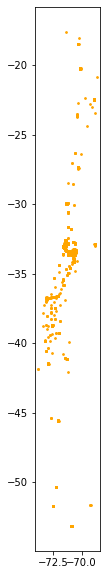

In [0]:
gdf_wifi_map = gpd.GeoDataFrame(data_merged, geometry=gpd.points_from_xy(data_merged.lon, data_merged.lat), crs=4674)
f, ax = plt.subplots(1, figsize=(10,10))
ax = gdf_wifi.plot(ax=ax,color='orange',markersize=3)

El DataFrame generado se transforma a PySpark DataFrame. **En dicho PySpark DataFrame ya estará incluida la información geográfica (manzana, comuna, provincia, región)**

In [0]:
dfgeo = spark.createDataFrame(data_merged).cache()
display(dfgeo)

/databricks/spark/python/pyspark/sql/pandas/conversion.py:300: UserWarning: createDataFrame attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Did not pass numpy.dtype object
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)

REGION,PROVINCIA,COMUNA,COD_DIS,COD_ZON,COD_ENT,MANZENT,DES_REGI,DES_PROV,DES_COMU,geometry,index_right,bssid,lat,lon,updated,year
1,11,1101,2,3,503,1101021003503,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122735136, false, 2)",38678,00147F25A83B,-20.20410000,-70.13108000,1428513555,2015
1,11,1101,2,2,11,1101021002011,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122734928, false, 2)",19404,00147F25A73F,-20.20483000,-70.13440000,1428513555,2015
1,11,1101,2,2,11,1101021002011,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122734832, false, 2)",5694,00147F2693C7,-20.20464000,-70.13511000,1428513555,2015
1,11,1101,2,2,12,1101021002012,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122722400, false, 2)",3611,00147F26928C,-20.20480000,-70.13601000,1428513555,2015
1,11,1101,2,2,12,1101021002012,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122722256, false, 2)",19888,00147F25BA2F,-20.20469000,-70.13597000,1428513555,2015
1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185117749440, false, 2)",3107,00147F26B09A,-20.20732000,-70.14036000,1428513555,2015
1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185113596608, false, 2)",38192,00147F26CE16,-20.20707000,-70.13487000,1428513555,2015
1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185123343904, false, 2)",13054,00147F267EA6,-20.20703000,-70.13693000,1428513555,2015
1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94184878186704, false, 2)",45385,00147F25A886,-20.20651000,-70.13769000,1428513555,2015
1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94184960945936, false, 2)",38685,00147F269664,-20.20646000,-70.13663000,1428513555,2015


In [0]:
dfgeo.count()

Out[19]: 24757

Se genera columna "OUI" con los primeros 3 octetos de la MAC Address para poder ser correlacionado con la tabla de providers

In [0]:
dfgeo = dfgeo.withColumn("oui", substring(dfgeo.bssid,1,6))
display(dfgeo)

REGION,PROVINCIA,COMUNA,COD_DIS,COD_ZON,COD_ENT,MANZENT,DES_REGI,DES_PROV,DES_COMU,geometry,index_right,bssid,lat,lon,updated,year,oui
1,11,1101,2,3,503,1101021003503,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122735136, false, 2)",38678,00147F25A83B,-20.20410000,-70.13108000,1428513555,2015,00147F
1,11,1101,2,2,11,1101021002011,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122734928, false, 2)",19404,00147F25A73F,-20.20483000,-70.13440000,1428513555,2015,00147F
1,11,1101,2,2,11,1101021002011,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122734832, false, 2)",5694,00147F2693C7,-20.20464000,-70.13511000,1428513555,2015,00147F
1,11,1101,2,2,12,1101021002012,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122722400, false, 2)",3611,00147F26928C,-20.20480000,-70.13601000,1428513555,2015,00147F
1,11,1101,2,2,12,1101021002012,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122722256, false, 2)",19888,00147F25BA2F,-20.20469000,-70.13597000,1428513555,2015,00147F
1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185117749440, false, 2)",3107,00147F26B09A,-20.20732000,-70.14036000,1428513555,2015,00147F
1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185113596608, false, 2)",38192,00147F26CE16,-20.20707000,-70.13487000,1428513555,2015,00147F
1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185123343904, false, 2)",13054,00147F267EA6,-20.20703000,-70.13693000,1428513555,2015,00147F
1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94184878186704, false, 2)",45385,00147F25A886,-20.20651000,-70.13769000,1428513555,2015,00147F
1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94184960945936, false, 2)",38685,00147F269664,-20.20646000,-70.13663000,1428513555,2015,00147F


Se ejecuta Join con la tabla de providers. **Con esto obtenemos el feature "provider" en el tablón que es igual a Fabricante**

In [0]:
dfgeo = dfgeo.join(df_oui,on='oui',how='left')
display(dfgeo)

oui,REGION,PROVINCIA,COMUNA,COD_DIS,COD_ZON,COD_ENT,MANZENT,DES_REGI,DES_PROV,DES_COMU,geometry,index_right,bssid,lat,lon,updated,year,provider
00147F,1,11,1101,2,3,503,1101021003503,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122735136, false, 2)",38678,00147F25A83B,-20.20410000,-70.13108000,1428513555,2015,ThomsonT
00147F,1,11,1101,2,2,11,1101021002011,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122734928, false, 2)",19404,00147F25A73F,-20.20483000,-70.13440000,1428513555,2015,ThomsonT
00147F,1,11,1101,2,2,11,1101021002011,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122734832, false, 2)",5694,00147F2693C7,-20.20464000,-70.13511000,1428513555,2015,ThomsonT
00147F,1,11,1101,2,2,12,1101021002012,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122722400, false, 2)",3611,00147F26928C,-20.20480000,-70.13601000,1428513555,2015,ThomsonT
00147F,1,11,1101,2,2,12,1101021002012,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185122722256, false, 2)",19888,00147F25BA2F,-20.20469000,-70.13597000,1428513555,2015,ThomsonT
00147F,1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185117749440, false, 2)",3107,00147F26B09A,-20.20732000,-70.14036000,1428513555,2015,ThomsonT
00147F,1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185113596608, false, 2)",38192,00147F26CE16,-20.20707000,-70.13487000,1428513555,2015,ThomsonT
00147F,1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94185123343904, false, 2)",13054,00147F267EA6,-20.20703000,-70.13693000,1428513555,2015,ThomsonT
00147F,1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94184878186704, false, 2)",45385,00147F25A886,-20.20651000,-70.13769000,1428513555,2015,ThomsonT
00147F,1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE,"List(94184960945936, false, 2)",38685,00147F269664,-20.20646000,-70.13663000,1428513555,2015,ThomsonT


Se filtran columnas de interés para mantener mayor orden en el PySpark DataFrame

In [0]:
df_geo = dfgeo.select('bssid','oui','provider','lat','lon','REGION', 'PROVINCIA', 'COMUNA', 'COD_DIS', 'COD_ZON', 'COD_ENT', 'MANZENT', 'DES_REGI', 'DES_PROV', 'DES_COMU')
display(df_geo)

bssid,oui,provider,lat,lon,REGION,PROVINCIA,COMUNA,COD_DIS,COD_ZON,COD_ENT,MANZENT,DES_REGI,DES_PROV,DES_COMU
00147F25A83B,00147F,ThomsonT,-20.20410000,-70.13108000,1,11,1101,2,3,503,1101021003503,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE
00147F25A73F,00147F,ThomsonT,-20.20483000,-70.13440000,1,11,1101,2,2,11,1101021002011,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE
00147F2693C7,00147F,ThomsonT,-20.20464000,-70.13511000,1,11,1101,2,2,11,1101021002011,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE
00147F26928C,00147F,ThomsonT,-20.20480000,-70.13601000,1,11,1101,2,2,12,1101021002012,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE
00147F25BA2F,00147F,ThomsonT,-20.20469000,-70.13597000,1,11,1101,2,2,12,1101021002012,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE
00147F26B09A,00147F,ThomsonT,-20.20732000,-70.14036000,1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE
00147F26CE16,00147F,ThomsonT,-20.20707000,-70.13487000,1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE
00147F267EA6,00147F,ThomsonT,-20.20703000,-70.13693000,1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE
00147F25A886,00147F,ThomsonT,-20.20651000,-70.13769000,1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE
00147F269664,00147F,ThomsonT,-20.20646000,-70.13663000,1,11,1101,2,5,3,1101021005003,REGIÓN DE TARAPACÁ,IQUIQUE,IQUIQUE


# Parte 3: Construcción de Features

#### Clustering
Se aplicará una clusterización mediante un *Gaussian Mixture Model* a las ubicaciones de las antenas con el fin de identificar y separarlas en diferentes zonas geográficas. Además, estos outputs (número de clústers) serán convertidos en features mediante una operación de one-hot encoder.

In [0]:
# Se filtra el dataset para tomar sólo los datos pertenencientes a la provincia de Santiago
df_prov = df_geo.filter(df_geo.DES_PROV == 'SANTIAGO')

# Se crea un dataset nuevo sólo con los bssid y la ubicación de las antenas
df_clustering = df_prov.select('bssid','lat','lon')

#Se muestra el nuevo dataset
df_clustering.show()

+------------+------------+------------+
 bssid| lat| lon|
+------------+------------+------------+
0014D1C3FBDA|-33.49892000|-70.71615000|
021B7700B84B|-33.51385000|-70.70753000|
00147F25ABE3|-33.53370000|-70.69980000|
00147F25B243|-33.51708000|-70.71719000|
00147F269AEA|-33.51708000|-70.71719000|
00147F2693AF|-33.51708000|-70.71719000|
00147F26AE64|-33.51691000|-70.71790000|
00147F25A4F0|-33.51673000|-70.71716000|
00147F26D84B|-33.48417000|-70.75024000|
00147F26823C|-33.48390000|-70.75021000|
00147F26737B|-33.48031000|-70.75107000|
00147F2693B8|-33.48168000|-70.74773000|
002401418F93|-33.48458000|-70.75676000|
0014BF3ABF93|-33.49497000|-70.78331000|
00147F267E4C|-33.49718000|-70.75843000|
00147F26950B|-33.50462000|-70.77401000|
00147F25A7DB|-33.51006000|-70.75874000|
00147F26C552|-33.50916000|-70.75881000|
0014D1C21572|-33.51511000|-70.75349000|
0014BF403575|-33.51770000|-70.76495000|
+------------+------------+------------+
only showing top 20 rows

Se preparan el dataset para ser insertado adecuadamente en el algoritmo de clusterización

In [0]:
df_clustering_1 = df_clustering.withColumn("lat", df_clustering["lat"].cast(DoubleType()))
df_clustering_2 = df_clustering_1.withColumn("lon", df_clustering["lon"].cast(DoubleType()))

from pyspark.ml.feature import VectorAssembler 

# Se transforman las latitudes y longitudes en un vector
assembler = VectorAssembler(inputCols=[
    'lat','lon'
], outputCol='features')
df_clustering_3 = assembler.transform(df_clustering_2)

# Check the resulting column
df_clustering_3.select('bssid', 'features').show(5, truncate=False)

+------------+---------------------+
bssid |features |
+------------+---------------------+
0014D1C3FBDA|[-33.49892,-70.71615]|
021B7700B84B|[-33.51385,-70.70753]|
00147F25ABE3|[-33.5337,-70.6998] |
00147F25B243|[-33.51708,-70.71719]|
00147F269AEA|[-33.51708,-70.71719]|
+------------+---------------------+
only showing top 5 rows

In [0]:
from pyspark.ml.clustering import GaussianMixture 

# Se prepara el modelo y se aplica para un total de 12 clusters, que luego de diferentes pruebas, resultó tener una distribución en más uniforme y diferenciada.
gmm = GaussianMixture().setK(12).setSeed(23)
model = gmm.fit(df_clustering_3)

In [0]:
# Se revisa el tamaño de los 12 clusters y se muestra por orden decreciente
df_clusters_12 = model.transform(df_clustering_3)
display(df_clusters_12.groupBy('prediction').count().orderBy('count', ascending=False))

prediction,count
10,1988
11,1922
1,1623
2,1381
4,661
5,572
6,471
8,421
3,292
9,276


/databricks/spark/python/pyspark/sql/pandas/conversion.py:92: UserWarning: toPandas attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Unable to convert the field features. If this column is not necessary, you may consider dropping it or converting to primitive type before the conversion.
Direct cause: Unsupported type in conversion to Arrow: VectorUDT
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)
Out[27]:

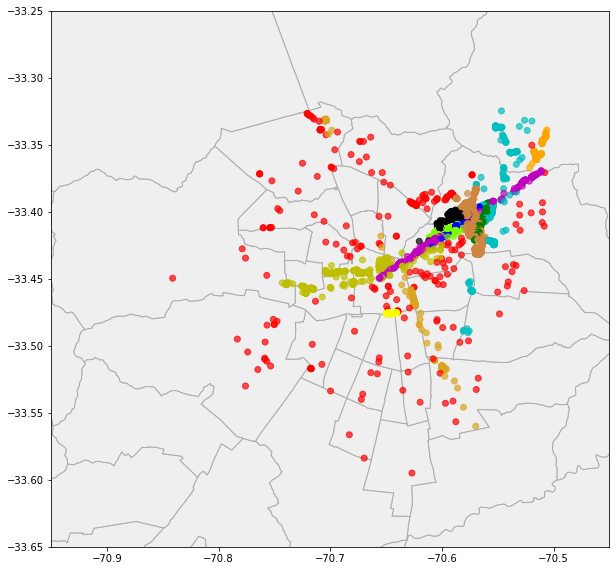

(-33.65, -33.25)

In [0]:
# Graficamos para obtener una representación visual del agrupamiento que se obtuvo como resultado
file_prov = '/dbfs/FileStore/tables/zonas_censales/R13/Comuna.shp'
forplot_gdf  = gpd.GeoDataFrame(gpd.read_file(file_prov), geometry='geometry')

df_clusters_pandas = df_clusters_12.toPandas()

gdf_plot_clusters = gpd.GeoDataFrame(
    df_clusters_pandas, geometry=gpd.points_from_xy(df_clusters_pandas.lat, df_clusters_pandas.lon), crs=4674)
f, ax = plt.subplots(1, figsize=(10,10))

categories = np.array(df_clusters_pandas['prediction'])
colormap = np.array(['r', 'g', 'b','c','m','y','k','orange','goldenrod','yellow','lawngreen','peru'])
ax = forplot_gdf.plot(ax=ax, color='#efefef', edgecolor='#abacab', linewidth=1)
ax.scatter(df_clusters_pandas['lon'], df_clusters_pandas['lat'], c=colormap[categories],alpha=0.7)
ax.set_xlim([-70.95,-70.45])
ax.set_ylim([-33.65,-33.25])
#ax.gca().set_aspect('equal', adjustable='box')

In [0]:
# Se crea un dataframe de tipo spark con los resultados
df_clusters_spark = spark.createDataFrame(df_clusters_pandas).cache()
# Seleccionamos las columnas necesarias para ser unidas al tablon principal
df_clusters=df_clusters_spark.select('bssid', 'prediction')

#Se ejecuta one hot encoder a prediction
#Se elimina prediction y la ultima columna
for i in np.unique(np.array(df_clusters_spark.select('prediction').collect())):
  df_clusters = df_clusters.withColumn(f'cluster_{int(i)}',F.when(df_clusters.prediction==int(i),1).otherwise(0))

df_clusters = df_clusters.drop('prediction',f'cluster_{int(i)}')

display(df_clusters)

/databricks/spark/python/pyspark/sql/pandas/conversion.py:300: UserWarning: createDataFrame attempted Arrow optimization because 'spark.sql.execution.arrow.pyspark.enabled' is set to true; however, failed by the reason below:
 Could not convert [-33.49892,-70.71615] with type DenseVector: did not recognize Python value type when inferring an Arrow data type
Attempting non-optimization as 'spark.sql.execution.arrow.pyspark.fallback.enabled' is set to true.
 warnings.warn(msg)

bssid,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,cluster_8,cluster_9,cluster_10
0014D1C3FBDA,1,0,0,0,0,0,0,0,0,0,0
021B7700B84B,1,0,0,0,0,0,0,0,0,0,0
00147F25ABE3,1,0,0,0,0,0,0,0,0,0,0
00147F25B243,1,0,0,0,0,0,0,0,0,0,0
00147F269AEA,1,0,0,0,0,0,0,0,0,0,0
00147F2693AF,1,0,0,0,0,0,0,0,0,0,0
00147F26AE64,1,0,0,0,0,0,0,0,0,0,0
00147F25A4F0,1,0,0,0,0,0,0,0,0,0,0
00147F26D84B,1,0,0,0,0,0,0,0,0,0,0
00147F26823C,1,0,0,0,0,0,0,0,0,0,0


Para la construcción de features por fabricante se procederá a utilizar las marcas que tengan mayor cantidad de muestras y el resto se catalogará como "otros".

In [0]:
display(df_geo.groupBy('provider').count())

provider,count
Belkin,5
Routerbo,79
Nokia,21
AMIT,1
Technico,3291
Cisco-Li,1165
Motorola,136
null,2048
Arcadyan,133
D-LinkIn,848


**Construcción de Feature: Cantidad de redes Wifi por Fabricante**

Datos por Comuna

In [0]:
#Cantidad de redes WiFi del fabricante X
#Se genera lista con fabricantes de interés
brand_list = ['%ARRISGro%','%Technico%','%Cisco%','%Link%','%tron%','%Shenzhen%']
r1 = df_geo

#Se genera columna para suma acumulativa
r1 = r1.withColumn('sum_q',F.when(r1.provider==1,0).otherwise(0))

#Se recorre la lista de fabricantes y se va generando la columna que 
#identifica si el router de la muestra pertenece a dicho fabricante
for i in brand_list:
    j = i.replace('%','')
    r1 = r1.withColumn(f'q_{j}',F.when(r1.provider.like(i),1).otherwise(0))
    r1 = r1.withColumn('sum_q',r1.sum_q+r1[f'q_{j}'])

#Si la suma acumulativa es cero, el fabricante no está en la lista, por lo que se marca
r1 = r1.withColumn('q_Other',F.when(r1.sum_q==0,1).otherwise(0))

#Se genera lista "limpia" para futuro renombre de columnas
brand_list_clean = ['q_'+x.replace('%','') for x in brand_list]
brand_list_clean.append('q_Other')

#Se guarda DF raw
r1_raw = r1

#Se genera la agrupación deseada
r1 = r1.select('DES_COMU',*brand_list_clean)\
                .groupBy('DES_COMU').sum()

#Se renombran columnas
for i in brand_list_clean:
    r1 = r1.withColumnRenamed(f"sum({i})", i)
  
display(r1)

DES_COMU,q_ARRISGro,q_Technico,q_Cisco,q_Link,q_tron,q_Shenzhen,q_Other
SALAMANCA,0,0,0,0,0,0,5
OVALLE,0,0,0,0,0,0,5
COQUIMBO,0,0,0,0,0,0,12
LA SERENA,0,0,0,0,0,0,26
VICUÑA,0,0,0,0,0,0,2
ANTOFAGASTA,0,0,0,1,0,0,30
ILLAPEL,0,0,1,0,0,0,5
CHAÑARAL,0,0,0,0,0,0,2
CALAMA,15,7,0,12,3,0,20
IQUIQUE,0,0,0,0,0,0,54


Datos por Manzana

In [0]:
r1_m = r1_raw.select('MANZENT',*brand_list_clean)\
                .groupBy('MANZENT').sum()
for i in brand_list_clean:
    r1_m = r1_m.withColumnRenamed(f"sum({i})", i)

display(r1_m)

MANZENT,q_ARRISGro,q_Technico,q_Cisco,q_Link,q_tron,q_Shenzhen,q_Other
5105021001050,0,0,6,0,0,0,5
5101011002003,1,0,2,0,0,0,0
5105011003013,0,0,0,0,0,2,0
5105021001022,0,0,0,0,0,0,2
5105041001003,0,0,0,1,0,3,5
5105011001011,0,0,0,0,0,2,1
5101021002008,34,12,2,8,6,1,29
5105081003019,0,0,0,1,0,0,5
5105011003011,0,0,0,1,0,2,1
5105011003015,0,0,0,0,0,0,1


**Construcción de Feature: Proporción de redes Wifi por Fabricante**

Datos por Comuna

In [0]:
#Proporcion de redes WiFi del fabricante X
r2 = r1

#Se genera columna para suma acumulativa
r2 = r2.withColumn('cumsum_tot',F.when(r1.DES_COMU==1,0).otherwise(0))

#Se recorren columnas con cantidades para obtener la suma acumulativa total
for i in r1.columns[1:]:
    r2 = r2.withColumn('cumsum_tot',r2.cumsum_tot+r2[i])

#Se recorren las columnas con cantidades para dividir entre la suma 
#acumulativa y obtener la proporción
for i in r1.columns[1:]:
    j=i.replace('q_','p_')
    r2 = r2.withColumn(j,r2[i]/r2.cumsum_tot)

display(r2)

DES_COMU,q_ARRISGro,q_Technico,q_Cisco,q_Link,q_tron,q_Shenzhen,q_Other,cumsum_tot,p_ARRISGro,p_Technico,p_Cisco,p_Link,p_tron,p_Shenzhen,p_Other
SALAMANCA,0,0,0,0,0,0,5,5,0.0,0.0,0.0,0.0,0.0,0.0,1.0
OVALLE,0,0,0,0,0,0,5,5,0.0,0.0,0.0,0.0,0.0,0.0,1.0
COQUIMBO,0,0,0,0,0,0,12,12,0.0,0.0,0.0,0.0,0.0,0.0,1.0
LA SERENA,0,0,0,0,0,0,26,26,0.0,0.0,0.0,0.0,0.0,0.0,1.0
VICUÑA,0,0,0,0,0,0,2,2,0.0,0.0,0.0,0.0,0.0,0.0,1.0
ANTOFAGASTA,0,0,0,1,0,0,30,31,0.0,0.0,0.0,0.03225806451612903,0.0,0.0,0.967741935483871
ILLAPEL,0,0,1,0,0,0,5,6,0.0,0.0,0.16666666666666666,0.0,0.0,0.0,0.8333333333333334
CHAÑARAL,0,0,0,0,0,0,2,2,0.0,0.0,0.0,0.0,0.0,0.0,1.0
CALAMA,15,7,0,12,3,0,20,57,0.2631578947368421,0.12280701754385964,0.0,0.21052631578947367,0.05263157894736842,0.0,0.3508771929824561
IQUIQUE,0,0,0,0,0,0,54,54,0.0,0.0,0.0,0.0,0.0,0.0,1.0


Datos por Manzana

In [0]:
r2_m = r1_m

r2_m = r2_m.withColumn('cumsum_tot',F.when(r2_m.MANZENT==1,0).otherwise(0))

for i in r1.columns[1:]:
    r2_m = r2_m.withColumn('cumsum_tot',r2_m.cumsum_tot+r2_m[i])

for i in r1.columns[1:]:
    j=i.replace('q_','p_')
    r2_m = r2_m.withColumn(j,r2_m[i]/r2_m.cumsum_tot)

display(r2_m)

MANZENT,q_ARRISGro,q_Technico,q_Cisco,q_Link,q_tron,q_Shenzhen,q_Other,cumsum_tot,p_ARRISGro,p_Technico,p_Cisco,p_Link,p_tron,p_Shenzhen,p_Other
5109041007004,6,4,1,2,1,0,2,16,0.375,0.25,0.0625,0.125,0.0625,0.0,0.125
5109041007019,1,0,2,2,0,0,0,5,0.2,0.0,0.4,0.4,0.0,0.0,0.0
5109041008028,0,1,0,0,0,0,0,1,0.0,1.0,0.0,0.0,0.0,0.0,0.0
5109041008017,1,1,0,1,0,0,1,4,0.25,0.25,0.0,0.25,0.0,0.0,0.25
5109041007005,4,13,3,2,0,0,2,24,0.16666666666666666,0.5416666666666666,0.125,0.08333333333333333,0.0,0.0,0.08333333333333333
5109041011017,1,0,1,0,1,0,3,6,0.16666666666666666,0.0,0.16666666666666666,0.0,0.16666666666666666,0.0,0.5
5109041009005,0,1,0,1,0,0,1,3,0.0,0.3333333333333333,0.0,0.3333333333333333,0.0,0.0,0.3333333333333333
5109041007006,0,0,0,1,0,0,0,1,0.0,0.0,0.0,1.0,0.0,0.0,0.0
5109041006001,102,115,54,113,5,29,205,623,0.1637239165329053,0.18459069020866772,0.08667736757624397,0.18138041733547353,0.008025682182985553,0.04654895666131621,0.3290529695024077
5109041007020,1,0,1,1,2,0,2,7,0.14285714285714285,0.0,0.14285714285714285,0.14285714285714285,0.2857142857142857,0.0,0.2857142857142857


**Se ejecuta join de la tabla de features por manzana con el tablón original, se añade feature RETAIL**

In [0]:
# Tablon sprint 3
df_sprint3 = df_geo.join(r2_m,on='MANZENT').join(dfretail[['MANZENT','ENTIDAD']],how='left',on='MANZENT')
df_sprint3 = df_sprint3.withColumn('RETAIL',F.when(df_sprint3.ENTIDAD.isNull(),0).otherwise(1)).drop('ENTIDAD').orderBy('bssid')
# se añade columna id para unir por indice
w = Window().orderBy("bssid")
df_sprint3 = df_sprint3.orderBy('bssid').select(row_number().over(w).alias("id"), col("*"))
display(df_sprint3)

id,MANZENT,bssid,oui,provider,lat,lon,REGION,PROVINCIA,COMUNA,COD_DIS,COD_ZON,COD_ENT,DES_REGI,DES_PROV,DES_COMU,q_ARRISGro,q_Technico,q_Cisco,q_Link,q_tron,q_Shenzhen,q_Other,cumsum_tot,p_ARRISGro,p_Technico,p_Cisco,p_Link,p_tron,p_Shenzhen,p_Other,RETAIL
1,6301011004018,0001E349901F,0001E3,Siemens,-34.57874000,-71.00517000,6,63,6301,1,4,18,REGIÓN DEL LIBERTADOR GENERAL BERNARDO O'HIGGINS,COLCHAGUA,SAN FERNANDO,0,0,0,0,0,0,1,1,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0
2,6110021003012,00026F51E27F,00026F,SenaoInt,-33.97511768,-70.70554775,6,61,6110,2,3,12,REGIÓN DEL LIBERTADOR GENERAL BERNARDO O'HIGGINS,CACHAPOAL,MOSTAZAL,0,0,0,0,0,0,3,3,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0
3,13114011001500,00026F5434FA,00026F,SenaoInt,-33.40283754,-70.57777118,13,131,13114,1,1,500,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,1,0,100,16,0,6,47,170,0.0058823529411764705,0.0,0.5882352941176471,0.09411764705882353,0.0,0.03529411764705882,0.27647058823529413,0
4,6101161002500,00026F57221F,00026F,SenaoInt,-34.14890921,-70.69982754,6,61,6101,16,2,500,REGIÓN DEL LIBERTADOR GENERAL BERNARDO O'HIGGINS,CACHAPOAL,RANCAGUA,4,4,1,23,0,0,17,49,0.08163265306122448,0.08163265306122448,0.02040816326530612,0.46938775510204084,0.0,0.0,0.3469387755102041,0
5,5109011002005,00026F6DD69C,00026F,SenaoInt,-33.02400299,-71.55971367,5,51,5109,1,2,5,REGIÓN DE VALPARAÍSO,VALPARAÍSO,VIÑA DEL MAR,43,6,2,5,8,3,24,91,0.4725274725274725,0.06593406593406594,0.02197802197802198,0.054945054945054944,0.08791208791208792,0.03296703296703297,0.26373626373626374,0
6,5109041006001,00026F74A96F,00026F,SenaoInt,-32.96925533,-71.54547079,5,51,5109,4,6,1,REGIÓN DE VALPARAÍSO,VALPARAÍSO,VIÑA DEL MAR,102,115,54,113,5,29,205,623,0.1637239165329053,0.18459069020866772,0.08667736757624397,0.18138041733547353,0.008025682182985553,0.04654895666131621,0.3290529695024077,0
7,5109041006001,00026F8D8033,00026F,SenaoInt,-32.97216027,-71.54523580,5,51,5109,4,6,1,REGIÓN DE VALPARAÍSO,VALPARAÍSO,VIÑA DEL MAR,102,115,54,113,5,29,205,623,0.1637239165329053,0.18459069020866772,0.08667736757624397,0.18138041733547353,0.008025682182985553,0.04654895666131621,0.3290529695024077,0
8,13114011001011,00026F9BCEFF,00026F,SenaoInt,-33.40327082,-70.57659585,13,131,13114,1,1,11,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,66,36,126,38,22,1,161,450,0.14666666666666667,0.08,0.28,0.08444444444444445,0.04888888888888889,0.0022222222222222222,0.35777777777777775,0
9,13114011001011,00026FA234B0,00026F,SenaoInt,-33.40320488,-70.57631792,13,131,13114,1,1,11,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,66,36,126,38,22,1,161,450,0.14666666666666667,0.08,0.28,0.08444444444444445,0.04888888888888889,0.0022222222222222222,0.35777777777777775,0
10,13114131009005,00026FAD4700,00026F,SenaoInt,-33.41604722,-70.60445848,13,131,13114,13,9,5,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,3,4,57,31,3,2,69,169,0.01775147928994083,0.023668639053254437,0.33727810650887574,0.1834319526627219,0.01775147928994083,0.011834319526627219,0.40828402366863903,0


In [0]:
display(df_sprint3.groupBy('RETAIL').count().orderBy('count', ascending=False))
#display(df_sprint3)

RETAIL,count
0,24682
1,75


**Se añade distancia a METRO, para construir feature CERCANIA_METRO**

In [0]:
#Se genera lista con coordenadas de estaciones de metros
list_lon = list(dfmetros.select('LONGITUD').toPandas()['LONGITUD'])
list_lat = list(dfmetros.select('LATITUD').toPandas()['LATITUD'])
list_metros = []


for i in range(0,len(list_lon)):
  list_metros.append([list_lon[i],list_lat[i],0])
  
#Funcion distancia euclidiana plano xy
def ec_dst(x1,y1,x2,y2):
  return ((x2-x1)**2+(y2-y1)**2)**(1/2)

#Funcion que encuentra la minima distancia a un punto dado y los puntos de la lista de input
def mindist_finder(array_loc,xx,yy):
  array_loc2 = [ec_dst(xx,yy,float(y[0]),float(y[1])) for x,y in enumerate(array_loc)]
  return np.sort(array_loc2)[0]

#Se genera un array con las minimas distancias
lon_df = np.array(df_sprint3.select("lon").orderBy('bssid').collect())
lat_df = np.array(df_sprint3.select("lat").orderBy('bssid').collect())
distances = []
k=0
for i,j in zip(lon_df,lat_df):
  distances.append(mindist_finder(list_metros,float(i[0]),float(j[0])))
  #k+=1
  #print(k, float(i[0]),float(j[0]), mindist_finder(list_metros,float(i[0]),float(j[0])))
  
#Dicho array se convierte a pyspark DataFrame
data = data = [[y+1,float(x)] for y,x in enumerate(distances)]
columnss = ['id','dist']

mindist = spark.createDataFrame(data,columnss,FloatType())

display(mindist)

id,dist
1,1.0592253841436627
2,0.3870652159095531
3,0.011460044816803839
4,0.5525565073884677
5,0.9209593904559926
6,0.9349479477968112
7,0.9332706006042512
8,0.01024039755377239
9,0.010049778760267027
10,0.003151444690746731


**Se añade feature cercania a METRO (binario) y se elimina la distancia**

In [0]:
#Se une el DataFrame creado con el tablón

# Se ejecuta el join por id ya que no se alteró el orden de la lista de minimas distancias
df_sprint31 = df_sprint3.join(mindist, "id", "left")
df_sprint31 = df_sprint31.drop('id')
df_sprint31 = df_sprint31.filter(df_sprint3.DES_PROV=='SANTIAGO')
df_sprint31 = df_sprint31.withColumn('CERCANIA_METRO',F.when(df_sprint31.dist<=0.005,1).otherwise(0)).drop('dist').orderBy('bssid')
display(df_sprint31)

print('count=',df_sprint31.count())

MANZENT,bssid,oui,provider,lat,lon,REGION,PROVINCIA,COMUNA,COD_DIS,COD_ZON,COD_ENT,DES_REGI,DES_PROV,DES_COMU,q_ARRISGro,q_Technico,q_Cisco,q_Link,q_tron,q_Shenzhen,q_Other,cumsum_tot,p_ARRISGro,p_Technico,p_Cisco,p_Link,p_tron,p_Shenzhen,p_Other,RETAIL,CERCANIA_METRO
13114011001500,00026F5434FA,00026F,SenaoInt,-33.40283754,-70.57777118,13,131,13114,1,1,500,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,1,0,100,16,0,6,47,170,0.0058823529411764705,0.0,0.5882352941176471,0.09411764705882353,0.0,0.03529411764705882,0.27647058823529413,0,0
13114011001011,00026F9BCEFF,00026F,SenaoInt,-33.40327082,-70.57659585,13,131,13114,1,1,11,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,66,36,126,38,22,1,161,450,0.14666666666666667,0.08,0.28,0.08444444444444445,0.04888888888888889,0.0022222222222222222,0.35777777777777775,0,0
13114011001011,00026FA234B0,00026F,SenaoInt,-33.40320488,-70.57631792,13,131,13114,1,1,11,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,66,36,126,38,22,1,161,450,0.14666666666666667,0.08,0.28,0.08444444444444445,0.04888888888888889,0.0022222222222222222,0.35777777777777775,0,0
13114131009005,00026FAD4700,00026F,SenaoInt,-33.41604722,-70.60445848,13,131,13114,13,9,5,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,3,4,57,31,3,2,69,169,0.01775147928994083,0.023668639053254437,0.33727810650887574,0.1834319526627219,0.01775147928994083,0.011834319526627219,0.40828402366863903,0,1
13101211002028,00026FE1C8C0,00026F,SenaoInt,-33.47592273,-70.64934343,13,131,13101,21,2,28,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,SANTIAGO,3,5,2,5,4,6,18,43,0.06976744186046512,0.11627906976744186,0.046511627906976744,0.11627906976744186,0.09302325581395349,0.13953488372093023,0.4186046511627907,0,1
13114011001011,00028AA89135,00028A,AmbitMic,-33.40397046,-70.57763326,13,131,13114,1,1,11,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,66,36,126,38,22,1,161,450,0.14666666666666667,0.08,0.28,0.08444444444444445,0.04888888888888889,0.0022222222222222222,0.35777777777777775,0,0
13101061002019,0002CF5EA7DE,0002CF,ZyGateCo,-33.44373729,-70.67776668,13,131,13101,6,2,19,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,SANTIAGO,0,0,0,1,0,2,4,7,0.0,0.0,0.0,0.14285714285714285,0.0,0.2857142857142857,0.5714285714285714,0,1
13114091003019,0002CF5EBFB7,0002CF,ZyGateCo,-33.42138310,-70.55893724,13,131,13114,9,3,19,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,0,0,0,1,0,0,4,5,0.0,0.0,0.0,0.2,0.0,0.0,0.8,0,0
13114011001500,0002CF5ECC5C,0002CF,ZyGateCo,-33.40209505,-70.57700693,13,131,13114,1,1,500,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,1,0,100,16,0,6,47,170,0.0058823529411764705,0.0,0.5882352941176471,0.09411764705882353,0.0,0.03529411764705882,0.27647058823529413,0,0
13114111005003,0002CF5ECCC9,0002CF,ZyGateCo,-33.41604528,-70.56866317,13,131,13114,11,5,3,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,46,33,6,26,26,6,51,194,0.23711340206185566,0.17010309278350516,0.030927835051546393,0.13402061855670103,0.13402061855670103,0.030927835051546393,0.26288659793814434,0,0


count= 9976

In [0]:
display(df_sprint31.groupBy('CERCANIA_METRO').count().orderBy('count', ascending=False))

CERCANIA_METRO,count
0,5204
1,4772


In [0]:
#Para ir viendo en el mapa si las coordenadas estan cerca o no
#display(df_sprint3.select('lat','lon','dist').filter(df_sprint3.dist<0.005).orderBy('dist', ascending=False))

**Se ejecuta join con Microdatos**

In [0]:
display(dfrmicrod)

_c0,FID,CUT,REGION,PROVINCIA,COMUNA,Shape__Are,Shape__Len,NOMBRE_DIS,CODIGO_DIS,MANZENT,ZONA_CENSA,MANZANA,TOTAL_PERS,TOTAL_HOMB,TOTAL_MUJE,PERSONAS_0,PERSONAS_6,PERSONAS_1,PERSONAS_M,PERSONAS_E,PUEBLOS_IN,TOTAL_VIV_,TOTAL_VI_1,VIV_OCUPA_,TOTAL_VIVI,CANTIDAD_H,VIV_TIPO_C,VIV_TIPO_D,VIV_TIPO_T,VIV_TIPO_P,VIV_TIPO_M,VIV_TIPO_1,VIV_TIPO_O,VIV_PARED_,VIV_PARE_1,VIV_PARE_2,VIV_PARE_3,VIV_PARE_4,VIV_PARE_5,VIV_TECHO_,VIV_TECH_1,VIV_TECH_2,VIV_TECH_3,VIV_TECH_4,VIV_TECH_5,VIV_TECH_6,VIV_PISO_P,VIV_PISO_R,VIV_PISO_B,VIV_PISO_C,VIV_PISO_T,VIV_MATERI,VIV_MATE_1,VIV_MATE_2,VIV_AGUA_R,VIV_AGUA_P,VIV_AGUA_C,VIV_AGUA_1,geometry
0,1,13101,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,SANTIAGO,14688.97265625,1045.70138095235,MATADERO,21,13101211002011,2,11,189,90,99,9,14,142,24,15,14,100,0,83,100,83,4,89,0,7,0,0,0,74,9,0,0,0,0,34,38,11,0,0,0,0,83,0,0,0,0,83,0,0,82,0,0,0,"POLYGON ((-7864555.5263201 -3958306.39649223, -7864550.10060812 -3958424.1447584, -7864539.38577318 -3958433.5466817, -7864536.9974135 -3958436.97261368, -7864536.82030419 -3958438.50588238, -7864536.86349615 -3958439.60568818, -7864536.90390513 -3958440.62395283, -7864537.1121839 -3958441.79635857, -7864537.46885154 -3958442.59815872, -7864538.32634558 -3958443.74720997, -7864539.05248262 -3958444.65657533, -7864539.475608 -3958445.08857062, -7864540.61206868 -3958446.10403319, -7864599.25818206 -3958449.84198785, -7864599.27109512 -3958436.15600037, -7864566.9479225 -3958433.80798723, -7864567.07716443 -3958432.00754163, -7864567.20629503 -3958430.20963197, -7864599.33332272 -3958432.53856028, -7864599.54360524 -3958425.91063786, -7864575.29899937 -3958424.05787905, -7864575.13502576 -3958424.04546772, -7864575.0746906 -3958424.0425317, -7864574.98674821 -3958424.03345675, -7864570.31244279 -3958423.51725202, -7864570.50847641 -3958421.72281351, -7864570.70428739 -3958419.93104439, -7864573.5360326 -3958420.24132764, -7864574.79305229 -3958380.05004024, -7864576.58885832 -3958380.10422285, -7864578.38455302 -3958380.16334329, -7864577.12074284 -3958420.57936957, -7864599.62297603 -3958422.29386824, -7864600.17612258 -3958380.27971579, -7864601.97259653 -3958380.30106854, -7864603.76907047 -3958380.32749257, -7864603.21358621 -3958422.5292832, -7864625.5399346 -3958423.72757742, -7864625.86932898 -3958383.48943529, -7864627.66591423 -3958383.50184658, -7864629.4624995 -3958383.51906224, -7864629.13265985 -3958423.79657376, -7864631.85831758 -3958423.75546956, -7864631.88692669 -3958425.55778224, -7864631.91542447 -3958427.36276431, -7864627.34954425 -3958427.43563087, -7864627.22531169 -3958427.43069302, -7864627.03662516 -3958427.42308608, -7864603.13143243 -3958426.14244959, -7864602.92059331 -3958432.78491878, -7864631.08776406 -3958434.60524934, -7864630.97288235 -3958436.40422732, -7864630.85766668 -3958438.20560779, -7864602.86415433 -3958436.40129131, -7864602.85135259 -3958450.0709975, -7864641.55847537 -3958452.53805629, -7864644.63078199 -3958452.41594447, -7864646.33897958 -3958451.6298914, -7864648.0416112 -3958450.70024024, -7864648.80915908 -3958449.80782324, -7864649.9327067 -3958447.75234173, -7864650.52080757 -3958445.71994838, -7864653.33607749 -3958425.54403635, -7864666.08872704 -3958317.53749193, -7864666.04431056 -3958315.37700567, -7864665.73517634 -3958313.470883, -7864664.75979496 -3958311.63175451, -7864663.41683662 -3958310.36861331, -7864661.92593468 -3958309.50076266, -7864660.16842256 -3958308.57312473, -7864657.10624601 -3958307.80269554, -7864565.64103167 -3958301.34072767, -7864564.99226168 -3958301.36661771, -7864562.51929919 -3958301.46497315, -7864560.3364353 -3958301.71506556, -7864558.48218654 -3958302.37526151, -7864557.73000074 -3958302.98421124, -7864556.69651059 -3958304.14459218, -7864555.98651488 -3958305.1608431, -7864555.5263201 -3958306.39649223))"
1,2,13102,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,CERRILLOS,4117.6953125,267.65298582278,DIVINO MAESTRO,3,13102031005035,5,35,80,39,41,8,7,51,14,Indeterminado,5,20,0,20,20,23,20,0,0,0,0

In [0]:
from pyspark.sql.functions import mean as _mean, stddev as _stddev, col

In [0]:
dfmic = dfrmicrod[['MANZENT','Shape__Are','Shape__Len','TOTAL_PERS','TOTAL_MUJE','PERSONAS_1','PERSONAS_E','VIV_OCUPA_','TOTAL_VIVI']]

#Se toma el promedio de la columna donde existen valores null
m_PERSONAS_E = np.array(dfmic.select(_mean(col('PERSONAS_E'))).collect())[0][0]
m_TOTAL_PERS = np.array(dfmic.select(_mean(col('TOTAL_PERS'))).collect())[0][0]
m_PERSONAS_1 = np.array(dfmic.select(_mean(col('PERSONAS_1'))).collect())[0][0]
m_TOTAL_MUJE = np.array(dfmic.select(_mean(col('TOTAL_MUJE'))).collect())[0][0]
m_TOTAL_PERS = np.array(dfmic.select(_mean(col('TOTAL_PERS'))).collect())[0][0]
m_VIV_OCUPA_ = np.array(dfmic.select(_mean(col('VIV_OCUPA_'))).collect())[0][0]
m_TOTAL_VIVI = np.array(dfmic.select(_mean(col('TOTAL_VIVI'))).collect())[0][0]

dfmic = dfmic.withColumn('p_PERS_EXT',F.when((dfmic.TOTAL_PERS=='Indeterminado') | (dfmic.PERSONAS_E=='Indeterminado'),m_PERSONAS_E/m_TOTAL_PERS).otherwise(dfmic.PERSONAS_E/dfmic.TOTAL_PERS))
dfmic = dfmic.withColumn('p_PERS_ADULT',F.when((dfmic.TOTAL_PERS=='Indeterminado') | (dfmic.PERSONAS_1=='Indeterminado'),m_PERSONAS_1/m_TOTAL_PERS).otherwise(dfmic.PERSONAS_1/dfmic.TOTAL_PERS))
dfmic = dfmic.withColumn('p_MUJERES',F.when((dfmic.TOTAL_PERS=='Indeterminado') | (dfmic.TOTAL_MUJE=='Indeterminado'),m_TOTAL_MUJE/m_TOTAL_PERS).otherwise(dfmic.TOTAL_MUJE/dfmic.TOTAL_PERS))
dfmic = dfmic.withColumn('p_VIV_OCUP',F.when((dfmic.VIV_OCUPA_=='Indeterminado') | (dfmic.TOTAL_VIVI=='Indeterminado'),m_VIV_OCUPA_/m_TOTAL_VIVI).otherwise(dfmic.VIV_OCUPA_/dfmic.TOTAL_VIVI))
dfmic = dfmic.select('MANZENT','Shape__Are','Shape__Len','TOTAL_PERS','p_PERS_EXT','p_PERS_ADULT','p_MUJERES','p_VIV_OCUP')
display(dfmic)

MANZENT,Shape__Are,Shape__Len,TOTAL_PERS,p_PERS_EXT,p_PERS_ADULT,p_MUJERES,p_VIV_OCUP
13101211002011,14688.97265625,1045.70138095235,189,0.07936507936507936,0.7513227513227513,0.5238095238095238,0.83
13102031005035,4117.6953125,267.65298582278,80,0.05728990355365037,0.6375,0.5125,1.0
13102031003007,2631.48046875,198.310669471558,29,0.0,0.5862068965517241,0.5517241379310345,1.0
13101211002010,4863.09765625,440.080762667814,146,0.07534246575342465,0.684931506849315,0.4657534246575342,1.0
13102021003001,7162.6328125,371.03688723598,74,0.0,0.5405405405405406,0.527027027027027,1.0
13101201002025,15411.72265625,538.828125783433,61,0.0,0.7049180327868853,0.4918032786885246,0.8636363636363636
13102031003017,7700.861328125,374.712167108823,59,0.05728990355365037,0.6949152542372882,0.5423728813559322,1.0
13101241001026,16242.384765625,512.585231961864,205,0.1024390243902439,0.624390243902439,0.5121951219512195,0.9583333333333334
13102041001038,4320.91015625,299.44487540392,47,0.05728990355365037,0.8085106382978723,0.574468085106383,0.9375
13101211002006,4872.447265625,449.701627268529,116,0.10344827586206896,0.603448275862069,0.5517241379310345,0.8913043478260869


**Se generan Features basados en los Microdatos**
* Área de Manzana
* Longitud de Manzana
* Total de Personas
* Porcentaje de personas Extranjeras
* Porcentaje de personas Adultas
* Porcentaje de Mujeres
* Porcentaje de Viviendas Ocupadas

In [0]:
#Se ejecuta join con tablon, se manejan valores null
df_sprint32 = df_sprint31.join(dfmic, "MANZENT", "left")

#Se toma el promedio de la columna donde existen valores null
m_Shape__Are = np.array(df_sprint32.select(_mean(col('Shape__Are'))).collect())[0][0]
m_Shape__Len = np.array(df_sprint32.select(_mean(col('Shape__Len'))).collect())[0][0]
m_TOTAL_PERS = np.array(df_sprint32.select(_mean(col('TOTAL_PERS'))).collect())[0][0]
m_p_PERS_EXT = np.array(df_sprint32.select(_mean(col('p_PERS_EXT'))).collect())[0][0]
m_p_PERS_ADULT = np.array(df_sprint32.select(_mean(col('p_PERS_ADULT'))).collect())[0][0]
m_p_MUJERES = np.array(df_sprint32.select(_mean(col('p_MUJERES'))).collect())[0][0]
m_p_VIV_OCUP = np.array(df_sprint32.select(_mean(col('p_VIV_OCUP'))).collect())[0][0]

#Donde no hay datos se reemplaza el valor por el promedio
df_sprint32 = df_sprint32.withColumn('Shape__Are',F.when(df_sprint32.Shape__Are.isNull(),m_Shape__Are).otherwise(df_sprint32.Shape__Are))
df_sprint32 = df_sprint32.withColumn('Shape__Len',F.when(df_sprint32.Shape__Len.isNull(),m_Shape__Len).otherwise(df_sprint32.Shape__Len))
df_sprint32 = df_sprint32.withColumn('TOTAL_PERS',F.when(df_sprint32.TOTAL_PERS.isNull(),m_TOTAL_PERS).otherwise(df_sprint32.TOTAL_PERS))
df_sprint32 = df_sprint32.withColumn('p_PERS_EXT',F.when(df_sprint32.p_PERS_EXT.isNull(),m_p_PERS_EXT).otherwise(df_sprint32.p_PERS_EXT))
df_sprint32 = df_sprint32.withColumn('p_PERS_ADULT',F.when(df_sprint32.p_PERS_ADULT.isNull(),m_p_PERS_ADULT).otherwise(df_sprint32.p_PERS_ADULT))
df_sprint32 = df_sprint32.withColumn('p_MUJERES',F.when(df_sprint32.p_MUJERES.isNull(),m_p_MUJERES).otherwise(df_sprint32.p_MUJERES))
df_sprint32 = df_sprint32.withColumn('p_VIV_OCUP',F.when(df_sprint32.p_VIV_OCUP.isNull(),m_p_VIV_OCUP).otherwise(df_sprint32.p_VIV_OCUP))
display(df_sprint32)

MANZENT,bssid,oui,provider,lat,lon,REGION,PROVINCIA,COMUNA,COD_DIS,COD_ZON,COD_ENT,DES_REGI,DES_PROV,DES_COMU,q_ARRISGro,q_Technico,q_Cisco,q_Link,q_tron,q_Shenzhen,q_Other,cumsum_tot,p_ARRISGro,p_Technico,p_Cisco,p_Link,p_tron,p_Shenzhen,p_Other,RETAIL,CERCANIA_METRO,Shape__Are,Shape__Len,TOTAL_PERS,p_PERS_EXT,p_PERS_ADULT,p_MUJERES,p_VIV_OCUP
13114011001500,00026F5434FA,00026F,SenaoInt,-33.40283754,-70.57777118,13,131,13114,1,1,500,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,1,0,100,16,0,6,47,170,0.0058823529411764705,0.0,0.5882352941176471,0.09411764705882353,0.0,0.03529411764705882,0.27647058823529413,0,0,226866.955078125,2362.60618374624,949,0.13909378292939936,0.6870389884088515,0.5679662802950474,0.8280871670702179
13114011001011,00026F9BCEFF,00026F,SenaoInt,-33.40327082,-70.57659585,13,131,13114,1,1,11,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,66,36,126,38,22,1,161,450,0.14666666666666667,0.08,0.28,0.08444444444444445,0.04888888888888889,0.0022222222222222222,0.35777777777777775,0,0,119399.66858806925,1523.3712255358287,658.3073463268366,0.15110695966182952,0.6962305429156176,0.542573335913129,0.8475137151032274
13114011001011,00026FA234B0,00026F,SenaoInt,-33.40320488,-70.57631792,13,131,13114,1,1,11,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,66,36,126,38,22,1,161,450,0.14666666666666667,0.08,0.28,0.08444444444444445,0.04888888888888889,0.0022222222222222222,0.35777777777777775,0,0,119399.66858806925,1523.3712255358287,658.3073463268366,0.15110695966182952,0.6962305429156176,0.542573335913129,0.8475137151032274
13114131009005,00026FAD4700,00026F,SenaoInt,-33.41604722,-70.60445848,13,131,13114,13,9,5,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,3,4,57,31,3,2,69,169,0.01775147928994083,0.023668639053254437,0.33727810650887574,0.1834319526627219,0.01775147928994083,0.011834319526627219,0.40828402366863903,0,1,119399.66858806925,1523.3712255358287,658.3073463268366,0.15110695966182952,0.6962305429156176,0.542573335913129,0.8475137151032274
13101211002028,00026FE1C8C0,00026F,SenaoInt,-33.47592273,-70.64934343,13,131,13101,21,2,28,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,SANTIAGO,3,5,2,5,4,6,18,43,0.06976744186046512,0.11627906976744186,0.046511627906976744,0.11627906976744186,0.09302325581395349,0.13953488372093023,0.4186046511627907,0,1,119399.66858806925,1523.3712255358287,658.3073463268366,0.15110695966182952,0.6962305429156176,0.542573335913129,0.8475137151032274
13114011001011,00028AA89135,00028A,AmbitMic,-33.40397046,-70.57763326,13,131,13114,1,1,11,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,66,36,126,38,22,1,161,450,0.14666666666666667,0.08,0.28,0.08444444444444445,0.04888888888888889,0.0022222222222222222,0.35777777777777775,0,0,119399.66858806925,1523.3712255358287,658.3073463268366,0.15110695966182952,0.6962305429156176,0.542573335913129,0.8475137151032274
13101061002019,0002CF5EA7DE,0002CF,ZyGateCo,-33.44373729,-70.67776668,13,131,13101,6,2,19,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,SANTIAGO,0,0,0,1,0,2,4,7,0.0,0.0,0.0,0.14285714285714285,0.0,0.2857142857142857,0.5714285714285714,0,1,119399.66858806925,1523.3712255358287,658.3073463268366,0.15110695966182952,0.6962305429156176,0.542573335913129,0.8475137151032274
13114091003019,0002CF5EBFB7,0002CF,ZyGateCo,-33.42138310,-70.55893724,13,131,13114,9,3,19,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,0,0,0,1,0,0,4,5,0.0,0.0,0.0,0.2,0.0,0.0,0.8,0,0,18161.13671875,718.083826024745,49,0.08163265306122448,0.7551020408163265,0.5714285714285714,0.9230769230769231
13114011001500,0002CF5ECC5C,0002CF,ZyGateCo,-33.40209505,-70.57700693,13,131,13114,1,1,500,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,1,0,100,16,0,6,47,170,0.0058823529411764705,0.0,0.5882352941176471,0.09411764705882353,0.0,0.03529411764705882,0.27647058823529413,0,0,226866.955078125,2362.60618374624,949,0.13909378292939936,0.6870389884088515,0.5679662802950474,0.8280871670702179
13114111005003,0002CF5ECCC9,0002CF,ZyGateCo,-33.41604528,-70.568663

**Se añaden features de numero de cluster**

In [0]:
#Se ejecuta join de clusters con tablon por bssid
df_sprint33 = df_sprint32.join(df_clusters, "bssid", "left")

display(df_sprint33)

bssid,MANZENT,oui,provider,lat,lon,REGION,PROVINCIA,COMUNA,COD_DIS,COD_ZON,COD_ENT,DES_REGI,DES_PROV,DES_COMU,q_ARRISGro,q_Technico,q_Cisco,q_Link,q_tron,q_Shenzhen,q_Other,cumsum_tot,p_ARRISGro,p_Technico,p_Cisco,p_Link,p_tron,p_Shenzhen,p_Other,RETAIL,CERCANIA_METRO,Shape__Are,Shape__Len,TOTAL_PERS,p_PERS_EXT,p_PERS_ADULT,p_MUJERES,p_VIV_OCUP,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,cluster_8,cluster_9,cluster_10
00026F5434FA,13114011001500,00026F,SenaoInt,-33.40283754,-70.57777118,13,131,13114,1,1,500,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,1,0,100,16,0,6,47,170,0.0058823529411764705,0.0,0.5882352941176471,0.09411764705882353,0.0,0.03529411764705882,0.27647058823529413,0,0,226866.955078125,2362.60618374624,949,0.13909378292939936,0.6870389884088515,0.5679662802950474,0.8280871670702179,0,0,0,0,0,0,0,0,0,0,0
00026F9BCEFF,13114011001011,00026F,SenaoInt,-33.40327082,-70.57659585,13,131,13114,1,1,11,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,66,36,126,38,22,1,161,450,0.14666666666666667,0.08,0.28,0.08444444444444445,0.04888888888888889,0.0022222222222222222,0.35777777777777775,0,0,119399.66858806925,1523.3712255358287,658.3073463268366,0.15110695966182952,0.6962305429156176,0.542573335913129,0.8475137151032274,0,0,1,0,0,0,0,0,0,0,0
00026FA234B0,13114011001011,00026F,SenaoInt,-33.40320488,-70.57631792,13,131,13114,1,1,11,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,66,36,126,38,22,1,161,450,0.14666666666666667,0.08,0.28,0.08444444444444445,0.04888888888888889,0.0022222222222222222,0.35777777777777775,0,0,119399.66858806925,1523.3712255358287,658.3073463268366,0.15110695966182952,0.6962305429156176,0.542573335913129,0.8475137151032274,0,0,1,0,0,0,0,0,0,0,0
00026FAD4700,13114131009005,00026F,SenaoInt,-33.41604722,-70.60445848,13,131,13114,13,9,5,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,3,4,57,31,3,2,69,169,0.01775147928994083,0.023668639053254437,0.33727810650887574,0.1834319526627219,0.01775147928994083,0.011834319526627219,0.40828402366863903,0,1,119399.66858806925,1523.3712255358287,658.3073463268366,0.15110695966182952,0.6962305429156176,0.542573335913129,0.8475137151032274,0,0,0,0,0,0,0,0,0,0,1
00026FE1C8C0,13101211002028,00026F,SenaoInt,-33.47592273,-70.64934343,13,131,13101,21,2,28,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,SANTIAGO,3,5,2,5,4,6,18,43,0.06976744186046512,0.11627906976744186,0.046511627906976744,0.11627906976744186,0.09302325581395349,0.13953488372093023,0.4186046511627907,0,1,119399.66858806925,1523.3712255358287,658.3073463268366,0.15110695966182952,0.6962305429156176,0.542573335913129,0.8475137151032274,0,0,0,0,0,0,0,0,0,1,0
00028AA89135,13114011001011,00028A,AmbitMic,-33.40397046,-70.57763326,13,131,13114,1,1,11,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,66,36,126,38,22,1,161,450,0.14666666666666667,0.08,0.28,0.08444444444444445,0.04888888888888889,0.0022222222222222222,0.35777777777777775,0,0,119399.66858806925,1523.3712255358287,658.3073463268366,0.15110695966182952,0.6962305429156176,0.542573335913129,0.8475137151032274,0,0,1,0,0,0,0,0,0,0,0
0002CF5EA7DE,13101061002019,0002CF,ZyGateCo,-33.44373729,-70.67776668,13,131,13101,6,2,19,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,SANTIAGO,0,0,0,1,0,2,4,7,0.0,0.0,0.0,0.14285714285714285,0.0,0.2857142857142857,0.5714285714285714,0,1,119399.66858806925,1523.3712255358287,658.3073463268366,0.15110695966182952,0.6962305429156176,0.542573335913129,0.8475137151032274,0,0,0,0,0,1,0,0,0,0,0
0002CF5EBFB7,13114091003019,0002CF,ZyGateCo,-33.42138310,-70.55893724,13,131,13114,9,3,19,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,0,0,0,1,0,0,4,5,0.0,0.0,0.0,0.2,0.0,0.0,0.8,0,0,18161.13671875,718.083826024745,49,0.08163265306122448,0.7551020408163265,0.5714285714285714,0.9230769230769231,0,0,0,1,0,0,0,0,0,0,0
0002CF5ECC5C,13114011001500,0002CF,ZyGateCo,-33.40209505,-70.57700693,13,131,13114,1,1,500,REGIÓN METROPOLITANA DE SANTIAGO,SANTIAGO,LAS CONDES,1,0,100,16,0,6,47,170,0.005882

**Se añade variable a predecir: *target***
Se toman en cuenta los valores de provider para ejecutar el agrupamiento por operador.
* **Blue_Operator:** Other
* **Green_Operator:** ARRISGro, Technico, Tron
* **Red_Operator:** Cisco, Link, Shenzhen

In [0]:
#['%ARRISGro%','%Technico%','%Cisco%','%Link%','%tron%','%Shenzhen%']
df_sprint33 = df_sprint33.withColumn('provider_reduced',F.when(df_sprint33.provider.like('%ARRISGro%'),'ARRISGro').when(df_sprint33.provider.like('%Technico%'),'Technico').when(df_sprint33.provider.like('%Cisco%'),'Cisco').when(df_sprint33.provider.like('%Link%'),'Link').when(df_sprint33.provider.like('%tron%'),'Tron').when(df_sprint33.provider.like('%Shenzhen%'),'Shenzhen').otherwise('Other'))

display(df_sprint33.groupBy('provider_reduced').count())

provider_reduced,count
Other,3704
Shenzhen,253
Cisco,1760
Tron,560
Link,1138
ARRISGro,1546
Technico,1233


In [0]:
#Se genera variable target
df_sprint33 = df_sprint33.withColumn('target',F.when(df_sprint33.provider_reduced.like('%ARRISGro%'),'Green_Operator').when(df_sprint33.provider_reduced.like('%Technico%'),'Green_Operator').when(df_sprint33.provider_reduced.like('%Cisco%'),'Red_Operator').when(df_sprint33.provider_reduced.like('%Link%'),'Red_Operator').when(df_sprint33.provider_reduced.like('%Tron%'),'Green_Operator').when(df_sprint33.provider_reduced.like('%Shenzhen%'),'Red_Operator').otherwise('Blue_Operator'))

display(df_sprint33.groupBy('target').count())

target,count
Blue_Operator,3704
Red_Operator,3151
Green_Operator,3339


In [0]:
#Se genera csv para comprobar peso de archivo
df_sprint33.toPandas().to_csv('/dbfs/FileStore/tables/df_sprint3.csv')

Se muestran datos geográficos diferenciando la variable target

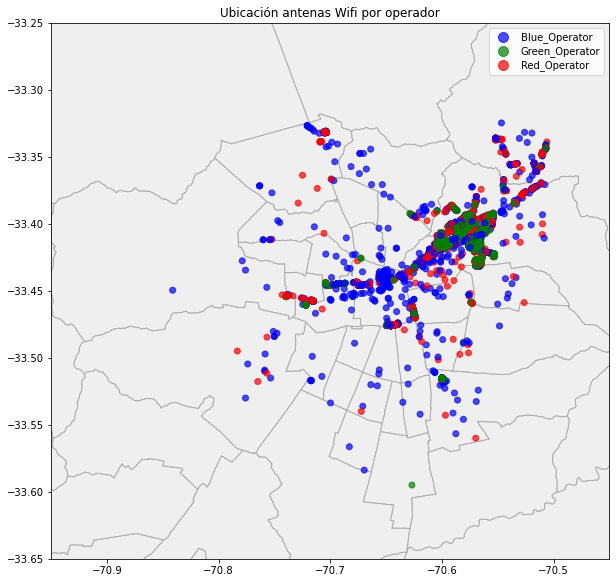

In [0]:
f, ax = plt.subplots(1, figsize=(10,10))

categories_target = np.array(df_sprint33.select('lon','lat','target').collect())
lon_target = categories_target[:,0].astype(np.float)
lat_target = categories_target[:,1].astype(np.float)
category_target = categories_target[:,2]

categories = np.where(category_target=='Blue_Operator',0,np.where(category_target=='Green_Operator',1,2))
colormap = np.array(['blue', 'green', 'red'])
ax = forplot_gdf.plot(ax=ax, color='#efefef', edgecolor='#abacab', linewidth=1)
ax.scatter(lon_target, lat_target, c=colormap[categories],alpha=0.7)
ax.set_xlim([-70.95,-70.45])
ax.set_ylim([-33.65,-33.25])
ax.set_title('Ubicación antenas Wifi por operador')

#Configuracion de leyenda
tl_legend = [('Blue_Operator','blue'),('Green_Operator','green'),('Red_Operator','red')]
for n, m in tl_legend:
    plt.scatter([], [], c=m, alpha=0.7, s=100, label=n)
    plt.legend(scatterpoints=1, labelspacing=0.3, loc=0)

# Parte 4: Datos mapeados por algoritmo

Se procede a implementar los siguientes procedimientos:
* Selección de features para tablón final
* Transformaciones de los datos del tablón final en features y labels para poder aplicar modelo en pySpark ML.
* Particionado train/test.
* Declaración de modelo y estimator.
* Generación de pipeline con transformaciones y modelo.
* Creación de grilla de iteración de hiperparámetros.
* Creación de modelo CrossValidator que tiene como estimador el pipeline, en parámetros usa la grilla, MultiClassEvaluator con métrica F1-score y 5 folds.
* Se ejecuta fit al modelo CrossValidator con los datos de train. El modelo resultante será el que tenga la combinación de hiperparámetros que resulten en el mejor valor de accuracy.
* Se ejecutan las predicciones con el set de test.

In [0]:
from pyspark.ml.classification import RandomForestClassifier
from pyspark.ml.evaluation import MulticlassClassificationEvaluator
from pyspark.ml import Pipeline
from pyspark.ml.feature import StringIndexer, VectorIndexer, IndexToString, StandardScaler
from pyspark.ml.tuning import CrossValidator, ParamGridBuilder
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns

In [0]:
#Se seleccionan features
df_sprint4 = df_sprint33.select('q_ARRISGro', 'q_Technico', 'q_Cisco', 'q_Link','q_tron', 'q_Shenzhen', 'q_Other', 'p_ARRISGro','p_Technico', 'p_Cisco', 'p_Link', 'p_tron', 'p_Shenzhen', 'p_Other','RETAIL','CERCANIA_METRO','Shape__Are','Shape__Len','TOTAL_PERS','p_PERS_EXT','p_PERS_ADULT','p_MUJERES','p_VIV_OCUP','cluster_0','cluster_1','cluster_2','cluster_3','cluster_4','cluster_5','cluster_6','cluster_7','cluster_8','cluster_9','cluster_10','target')

df_sprint4 = df_sprint4.withColumn("Shape__Are", df_sprint4["Shape__Are"].cast(DoubleType()))
df_sprint4 = df_sprint4.withColumn("Shape__Len", df_sprint4["Shape__Len"].cast(DoubleType()))
df_sprint4 = df_sprint4.withColumn("TOTAL_PERS", df_sprint4["TOTAL_PERS"].cast(DoubleType()))

# Se ejecuta labelIndexer para la variable a predecir (5 clases)
labelIndexer = StringIndexer(inputCol="target",outputCol="indexedLabel")

# Se ensambla un vector de features continuos
assembler_before_scale = VectorAssembler(inputCols=['q_ARRISGro', 'q_Technico', 'q_Cisco', 'q_Link','q_tron', 'q_Shenzhen', 'q_Other', 'p_ARRISGro','p_Technico', 'p_Cisco', 'p_Link', 'p_tron', 'p_Shenzhen', 'p_Other','Shape__Are','Shape__Len','TOTAL_PERS','p_PERS_EXT','p_PERS_ADULT','p_MUJERES','p_VIV_OCUP'], outputCol='features_not_std')

# Se aplica StandardScaler al vector de features continuos
scaler = StandardScaler(inputCol='features_not_std', outputCol="scaledFeatures",withStd=True, withMean=False)

# Se ensambla un vector final de features con los features continuos estandarizados y los features categóricos
assembler = VectorAssembler(inputCols=["scaledFeatures", 'RETAIL','CERCANIA_METRO','cluster_0','cluster_1','cluster_2','cluster_3','cluster_4','cluster_5','cluster_6','cluster_7','cluster_8','cluster_9','cluster_10'], outputCol='features')

#Se declara el modelo a utilizar
rf= RandomForestClassifier(labelCol="indexedLabel",featuresCol="features")

# Se genera el pipeline con las transformaciones y el modelo
pipeline = Pipeline(stages=[labelIndexer, assembler_before_scale, scaler, assembler,rf])

# Separación train/test
(trainingData, testData) = df_sprint4.randomSplit([0.7, 0.3])

#Se hace fit a los datos de train en el pipeline
model= pipeline.fit(trainingData)

# Se declara columnas y métricas de evaluación en MulticlassClassificationEvaluator
rfevaluator = MulticlassClassificationEvaluator(labelCol="indexedLabel", predictionCol="prediction",metricName="f1")

# Crear ParamGrid para Cross Validation
rfparamGrid = (ParamGridBuilder()
             .addGrid(rf.maxDepth, [5, 10])#
             .addGrid(rf.maxBins, [10, 40])#
             .addGrid(rf.numTrees, [20, 50])#
             .build())

# Crear 5-fold CrossValidator
rfcv = CrossValidator(estimator = pipeline,
                      estimatorParamMaps = rfparamGrid,
                      evaluator = rfevaluator,
                      numFolds = 5)

# Hacer fit a las cross validations.
rfcvModel = rfcv.fit(trainingData)
print(rfcvModel)
print(rfcvModel.getEstimatorParamMaps()[ np.argmax(rfcvModel.avgMetrics) ])
print(rfcvModel.avgMetrics[ np.argmax(rfcvModel.avgMetrics) ])

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.
CrossValidatorModel_532e644077d5
{Param(parent='RandomForestClassifier_a733d2bcf1b3', name='maxDepth', doc='Maximum depth of the tree. (>= 0) E.g., depth 0 means 1 leaf node; depth 1 means 1 internal node + 2 leaf nodes.'): 5, Param(parent='RandomForestClassifier_a733d2bcf1b3', name='maxBins', doc='Max number of bins for discretizing continuous features. Must be >=2 and >= number of categories for any categorical feature.'): 40, Param(parent='RandomForestClassifier_a733d2bcf1b3', name='numTrees', doc='Number of trees to train (>= 1).'): 20}
0.5369787594942576

# **Resultados:**
### **Mejor Modelo:**

MLlib will automatically track trials in MLflow. After your tuning fit() call has completed, view the MLflow UI to see logged runs.
CrossValidatorModel_532e644077d5

{Param(parent='RandomForestClassifier_a733d2bcf1b3', name='**maxDepth**', doc='Maximum depth of the tree. (>= 0) E.g., depth 0 means 1 leaf node; depth 1 means 1 internal node + 2 leaf nodes.'): **5**, Param(parent='RandomForestClassifier_a733d2bcf1b3', name='**maxBins**', doc='Max number of bins for discretizing continuous features.  Must be >=2 and >= number of categories for any categorical feature.'): **40**, Param(parent='RandomForestClassifier_a733d2bcf1b3', name='**numTrees**', doc='Number of trees to train (>= 1).'): **20**}


**F1-Score en set de train 0.5369787594942576**

### **Predicciones con set de test**

In [0]:
# Make predictions.
predictions= rfcvModel.transform(testData)

f1score= rfevaluator.evaluate(predictions)
print(f'F1-Score en set de test = {f1score}')

F1-Score en set de test = 0.5324658552907221

### **Ejecución del modelo con los mejores hiperparámetros:**

In [0]:
#Se seleccionan features
df_sprint4 = df_sprint33.select('lon','lat','q_ARRISGro', 'q_Technico', 'q_Cisco', 'q_Link','q_tron', 'q_Shenzhen', 'q_Other', 'p_ARRISGro','p_Technico', 'p_Cisco', 'p_Link', 'p_tron', 'p_Shenzhen', 'p_Other','RETAIL','CERCANIA_METRO','Shape__Are','Shape__Len','TOTAL_PERS','p_PERS_EXT','p_PERS_ADULT','p_MUJERES','p_VIV_OCUP','cluster_0','cluster_1','cluster_2','cluster_3','cluster_4','cluster_5','cluster_6','cluster_7','cluster_8','cluster_9','cluster_10','target')

df_sprint4 = df_sprint4.withColumn("Shape__Are", df_sprint4["Shape__Are"].cast(DoubleType()))
df_sprint4 = df_sprint4.withColumn("Shape__Len", df_sprint4["Shape__Len"].cast(DoubleType()))
df_sprint4 = df_sprint4.withColumn("TOTAL_PERS", df_sprint4["TOTAL_PERS"].cast(DoubleType()))

# Se ejecuta labelIndexer para la variable a predecir (5 clases)
labelIndexer = StringIndexer(inputCol="target",outputCol="indexedLabel")

# Se ensambla un vector de features continuos
assembler_before_scale = VectorAssembler(inputCols=['q_ARRISGro', 'q_Technico', 'q_Cisco', 'q_Link','q_tron', 'q_Shenzhen', 'q_Other', 'p_ARRISGro','p_Technico', 'p_Cisco', 'p_Link', 'p_tron', 'p_Shenzhen', 'p_Other','Shape__Are','Shape__Len','TOTAL_PERS','p_PERS_EXT','p_PERS_ADULT','p_MUJERES','p_VIV_OCUP'], outputCol='features_not_std')

# Se aplica StandardScaler al vector de features continuos
scaler = StandardScaler(inputCol='features_not_std', outputCol="scaledFeatures",withStd=True, withMean=False)

# Se ensambla un vector final de features con los features continuos estandarizados y los features categóricos
assembler = VectorAssembler(inputCols=["scaledFeatures", 'RETAIL','CERCANIA_METRO','cluster_0','cluster_1','cluster_2','cluster_3','cluster_4','cluster_5','cluster_6','cluster_7','cluster_8','cluster_9','cluster_10'], outputCol='features')

# Separación train/test
(trainingData, testData) = df_sprint4.randomSplit([0.7, 0.3])

# Modelo configurando hiperparámetros optimizados, para no tener que volver a correr el ParamGridSearch
rf_tuned= RandomForestClassifier(labelCol="indexedLabel",featuresCol="features", maxDepth=5, maxBins=40, numTrees=20)
pipeline_tuned = Pipeline(stages=[labelIndexer, assembler_before_scale, scaler, assembler,rf_tuned])
model_tuned= pipeline_tuned.fit(trainingData)

# Se declara columnas y métricas de evaluación en MulticlassClassificationEvaluator
rfevaluator = MulticlassClassificationEvaluator(labelCol="indexedLabel", predictionCol="prediction",metricName="f1")

# Predicciones
predictions_tuned= model_tuned.transform(testData)
f1_tuned= rfevaluator.evaluate(predictions_tuned)
print(f'F1 score testSet = {f1_tuned}')

F1 score testSet = 0.5315225223917731

El **F1-score** con el set de test resultó en **53.15%** para la ejecución del modelo con los mejores hiperparámetros.

### **Feature Importances para aplicación del modelo RandomForest con los mejores hiperparámetros.**

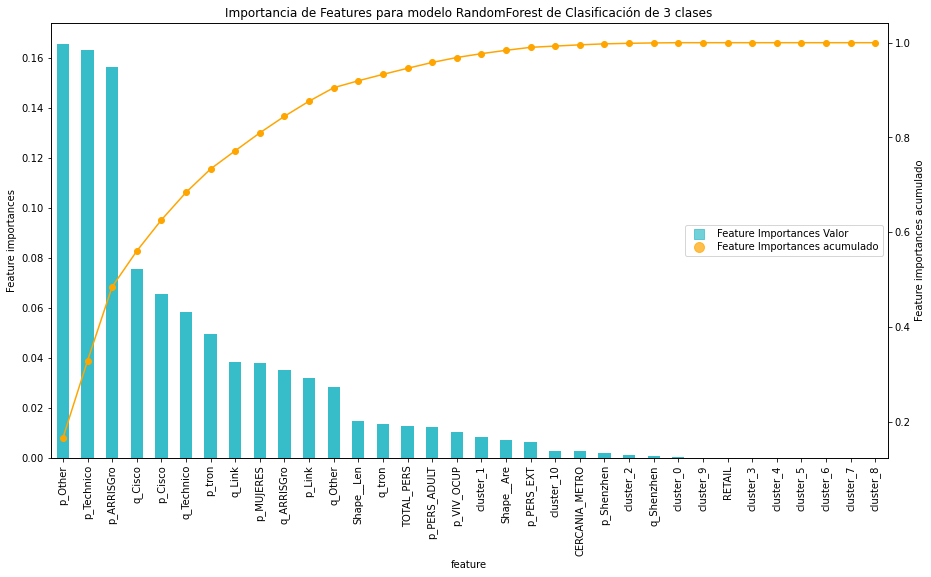

In [0]:
# Variable tree para obtener los feature importances (último stage del pipeline)
tree = model_tuned.stages[-1]

#Lista de features
feature_list = ['q_ARRISGro', 'q_Technico', 'q_Cisco', 'q_Link','q_tron', 'q_Shenzhen', 'q_Other', 'p_ARRISGro','p_Technico', 'p_Cisco', 'p_Link', 'p_tron', 'p_Shenzhen', 'p_Other','Shape__Are','Shape__Len','TOTAL_PERS','p_PERS_EXT','p_PERS_ADULT','p_MUJERES','p_VIV_OCUP', 'RETAIL','CERCANIA_METRO','cluster_0','cluster_1','cluster_2','cluster_3','cluster_4','cluster_5','cluster_6','cluster_7','cluster_8','cluster_9','cluster_10']

#Se genera lista con features y feature importances
aa = list(zip(feature_list, tree.featureImportances))

#Se guardan los valores de feature importances en un DataFrame
df_fi = pd.DataFrame(columns=['feature','importance'])

for i in aa:
  df_fi.loc[-1] = [i[0],i[1]]  
  df_fi.index = df_fi.index + 1 
  df_fi = df_fi.sort_index()
  
df_fi = df_fi.sort_values(by='importance',ascending=False).reset_index(drop=True)
df_fi['cumsum_importance'] = df_fi.importance.cumsum()

#Se grafican features importances
#Las barras se ordenan de mayor a menor con la importancia de cada feature
#La línea representa la importancia de features acumulada
fig, axes = plt.subplots(1,figsize=(15,8))
ax = axes
ax.set_title('Importancia de Features para modelo RandomForest de Clasificación de 3 clases')
ax = df_fi.plot(x='feature',y='importance',kind='bar', ax=ax,legend=False,color='#37BCCA')
ax.set_ylabel('Feature importances')


ax2 = ax.twinx()
ax2.plot(df_fi.cumsum_importance, color='orange')
ax2.scatter(df_fi.feature,df_fi.cumsum_importance, color='orange')
ax2.set_ylabel('Feature importances acumulado')

tl_legend = [('Feature Importances Valor','#37BCCA','s'),('Feature Importances acumulado','orange','o')]
for n, m, k in tl_legend:
    plt.scatter([], [], c=m, alpha=0.7, s=100, label=n,marker=k)
    plt.legend(scatterpoints=1, labelspacing=0.3, loc='center right')

### **Matriz de confusión para los resultados en el set de test: **

precision recall f1-score support

 0.0 0.60 0.49 0.54 1129
 1.0 0.51 0.74 0.61 1017
 2.0 0.51 0.39 0.44 936

 accuracy 0.54 3082
 macro avg 0.54 0.54 0.53 3082
weighted avg 0.55 0.54 0.53 3082

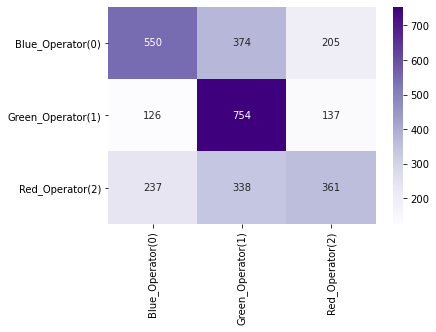

In [0]:
#Se obtienen valores reales y predicciones
results = np.array(predictions_tuned.select('indexedLabel','prediction').collect())
y_true = results[:,0]
y_pred = results[:,1]

# Other = 0, Cisco=1, ARRISGro=2, Technico=3, Tp-LinkT=4
LABELS = ['Blue_Operator(0)','Green_Operator(1)','Red_Operator(2)']
cfm = confusion_matrix(y_true,y_pred)
sns.heatmap(cfm, annot=True, fmt='g',cmap='Purples',xticklabels=LABELS, yticklabels=LABELS)
print(classification_report(y_true,y_pred))

### **Comparación gráfica de valores reales y predichos en mapa**
Se capturan valores reales del set de test con su latitud y longitud y se procede a comparar gráficamente en el mapa con los valores predichos:

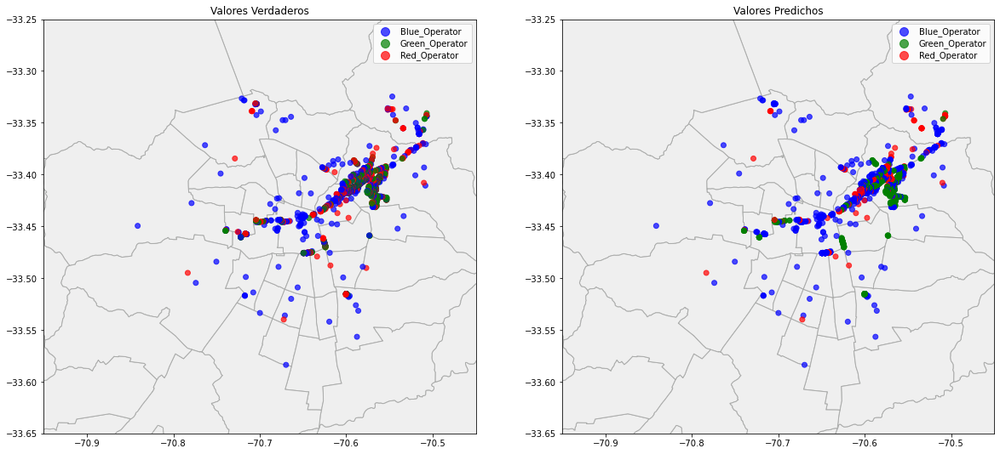

In [0]:
test_eval_data = np.array(testData.select('lat','lon','target').collect())
lat_eval  = test_eval_data[:,0].astype(np.float)
lon_eval  = test_eval_data[:,1].astype(np.float)
ytrue_eval_label  = test_eval_data[:,2]
ytrue_eval = np.where(ytrue_eval_label=='Blue_Operator',0,np.where(ytrue_eval_label=='Green_Operator',1,2))
ytrue_eval

# Other = 0, Cisco=1, ARRISGro=2, Technico=3, Tp-LinkT=4
#LABELS = ['Blue_Operator(0)','Green_Operator(1)','Red_Operator(2)']
#cfm = confusion_matrix(ytrue_eval,y_pred)
#sns.heatmap(cfm, annot=True, fmt='g',cmap='Purples',xticklabels=LABELS, yticklabels=LABELS)
#print(classification_report(ytrue_eval,y_pred))

f, axes = plt.subplots(nrows=1,ncols=2, figsize=(20,10))
axes = axes.flatten()

tl_legend = [('Blue_Operator','blue'),('Green_Operator','green'),('Red_Operator','red')]


ax = axes[0]
ax = forplot_gdf.plot(ax=ax, color='#efefef', edgecolor='#abacab', linewidth=1)
colormap = np.array(['blue', 'green', 'red'])
ax.scatter(lon_eval, lat_eval, c=colormap[ytrue_eval],alpha=0.7)
ax.set_xlim([-70.95,-70.45])
ax.set_ylim([-33.65,-33.25])
ax.set_title('Valores Verdaderos')
for n, m in tl_legend:
    ax.scatter([], [], c=m, alpha=0.7, s=100, label=n)
    ax.legend(scatterpoints=1, labelspacing=0.3, loc=0)

ax = axes[1]
ax = forplot_gdf.plot(ax=ax, color='#efefef', edgecolor='#abacab', linewidth=1)
colormap = np.array(['blue', 'green', 'red'])
ax.scatter(lon_eval, lat_eval, c=colormap[y_pred.astype(np.int)],alpha=0.7)
ax.set_xlim([-70.95,-70.45])
ax.set_ylim([-33.65,-33.25])
ax.set_title('Valores Predichos')
for n, m in tl_legend:
    ax.scatter([], [], c=m, alpha=0.7, s=100, label=n)
    ax.legend(scatterpoints=1, labelspacing=0.3, loc=0)

Se verifica asignación de labels

In [0]:
df_testing = labelIndexer.fit(testData).transform(testData)
display(df_testing.select('target','indexedLabel').groupBy('target','indexedLabel').count())

target,indexedLabel,count
Blue_Operator,0.0,1148
Red_Operator,2.0,945
Green_Operator,1.0,1003


### **Verificación de cada stage del pipeline en la aplicación del modelo**

A modo de verificación se procede a imprimir cómo va quedando el set de test en cada stage del pipeline:

**Stage0: LabelIndexer en donde la variable target se codifica**

In [0]:
stg0 = labelIndexer.fit(testData).transform(testData)
display(stg0.select('target','indexedLabel'))

target,indexedLabel
Red_Operator,2.0
Red_Operator,2.0
Green_Operator,1.0
Green_Operator,1.0
Blue_Operator,0.0
Red_Operator,2.0
Green_Operator,1.0
Blue_Operator,0.0
Red_Operator,2.0
Blue_Operator,0.0


**Stage1: Se genera un Vector de features continuos sin estandarizar para proceder a la estandarización de los valores**

In [0]:
stg1 = assembler_before_scale.transform(stg0)
display(stg1.select('features_not_std'))

features_not_std
"Map(vectorType -> dense, length -> 21, values -> List(1.0, 0.0, 0.0, 3.0, 0.0, 0.0, 1.0, 0.2, 0.0, 0.0, 0.6, 0.0, 0.0, 0.2, 283503.412109375, 4992.9107484218, 441.0, 0.09977324263038549, 0.7188208616780045, 0.4943310657596372, 0.9391304347826087))"
"Map(vectorType -> dense, length -> 21, values -> List(0.0, 2.0, 3.0, 0.0, 0.0, 0.0, 2.0, 0.0, 0.2857142857142857, 0.42857142857142855, 0.0, 0.0, 0.0, 0.2857142857142857, 769178.376953125, 21003.6338034704, 1681.0, 0.1618084473527662, 0.6829268292682927, 0.5318262938726949, 0.8215686274509804))"
"Map(vectorType -> dense, length -> 21, values -> List(1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.3333333333333333, 0.0, 0.0, 0.0, 0.3333333333333333, 0.0, 0.3333333333333333, 100076.546875, 2612.25420329634, 245.0, 0.08979591836734693, 0.6816326530612244, 0.5795918367346938, 0.9836065573770492))"
"Map(vectorType -> dense, length -> 21, values -> List(1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0, 0.3333333333333333, 0.0, 0.0, 0.0, 0.3333333333333333, 0.0, 0.3333333333333333, 100076.546875, 2612.25420329634, 245.0, 0.08979591836734693, 0.6816326530612244, 0.5795918367346938, 0.9836065573770492))"
"Map(vectorType -> sparse, length -> 21, indices -> List(6, 13, 14, 15, 16, 17, 18, 19, 20), values -> List(1.0, 1.0, 143393.46484375, 3096.92244137726, 584.0, 0.11986301369863013, 0.7123287671232876, 0.5222602739726028, 0.8446601941747572))"
"Map(vectorType -> sparse, length -> 21, indices -> List(0, 2, 7, 9, 14, 15, 16, 17, 18, 19, 20), values -> List(1.0, 2.0, 0.3333333333333333, 0.6666666666666666, 63692.587890625, 2011.68598865783, 120.0, 0.175, 0.6416666666666667, 0.5083333333333333, 0.8823529411764706))"
"Map(vectorType -> dense, length -> 21, values -> List(2.0, 1.0, 0.0, 3.0, 0.0, 0.0, 1.0, 0.2857142857142857, 0.14285714285714285, 0.0, 0.42857142857142855, 0.0, 0.0, 0.14285714285714285, 16979.978515625, 499.908407570263, 46.0, -9999.0, 0.7608695652173914, 0.5869565217391305, 0.9090909090909091))"
"Map(vectorType -> sparse, length -> 21, indices -> List(6, 13, 14, 15, 16, 17, 18, 19, 20), values -> List(1.0, 1.0, 60563.28515625, 1972.11934451657, 349.0, 0.0659025787965616, 0.7822349570200573, 0.504297994269341, 0.9871794871794872))"
"Map(vectorType -> dense, length -> 21, values -> List(2.0, 1.0, 0.0, 3.0, 0.0, 0.0, 1.0, 0.2857142857142857, 0.14285714285714285, 0.0, 0.42857142857142855, 0.0, 0.0, 0.14285714285714285, 16979.978515625, 499.908407570263, 46.0, -9999.0, 0.7608695652173914, 0.5869565217391305, 0.9090909090909091))"
"Map(vectorType -> sparse, length -> 21, indices -> List(3, 6, 10, 13, 14, 15, 16, 17, 18, 19, 20), values -> List(3.0, 4.0, 0.42857142857142855, 0.5714285714285714, 40785.89453125, 975.833914909558, 108.0, 0.12037037037037036, 0.6574074074074074, 0.5277777777777778, 0.9166666666666666))"


**Stage2: Se estandarizan los valores continuos del tablón y se guardan en un vector**

In [0]:
stg2 = scaler.fit(stg1).transform(stg1)
display(stg2.select('scaledFeatures'))

scaledFeatures
"Map(vectorType -> dense, length -> 21, values -> List(0.048806791145979814, 0.0, 0.0, 0.284803586015446, 0.0, 0.0, 0.02723320777124132, 1.6671634696954722, 0.0, 0.0, 7.441875902322497, 0.0, 0.0, 0.9917484539881596, 1.3422596578358292, 1.063049390218319, 0.10417320278763152, 2.256320860487157E-5, 1.7924196625725895E-4, 1.2449603581869183E-4, 2.3927570300089592E-4))"
"Map(vectorType -> dense, length -> 21, values -> List(0.0, 0.1624624740185007, 0.04659470189995338, 0.0, 0.0, 0.0, 0.05446641554248264, 0.0, 2.833267619048463, 2.2347488013106545, 0.0, 0.0, 0.0, 1.4167835056973708, 3.641709626639372, 4.47192053537221, 0.3970865167483188, 3.659215291995504E-5, 1.7029159031658336E-4, 1.3393911472982587E-4, 2.0932279864012654E-4))"
"Map(vectorType -> dense, length -> 21, values -> List(0.048806791145979814, 0.0, 0.0, 0.0, 0.12226355805125598, 0.0, 0.02723320777124132, 2.778605782825787, 0.0, 0.0, 0.0, 6.1342853829405115, 0.0, 1.652914089980266, 0.4738169130536076, 0.5561796270416365, 0.05787400154868418, 2.030688774438441E-5, 1.699688803057793E-4, 1.459687465837506E-4, 2.506075213579511E-4))"
"Map(vectorType -> dense, length -> 21, values -> List(0.048806791145979814, 0.0, 0.0, 0.0, 0.12226355805125598, 0.0, 0.02723320777124132, 2.778605782825787, 0.0, 0.0, 0.0, 6.1342853829405115, 0.0, 1.652914089980266, 0.4738169130536076, 0.5561796270416365, 0.05787400154868418, 2.030688774438441E-5, 1.699688803057793E-4, 1.459687465837506E-4, 2.506075213579511E-4))"
"Map(vectorType -> sparse, length -> 21, indices -> List(6, 13, 14, 15, 16, 17, 18, 19, 20), values -> List(0.02723320777124132, 4.958742269940798, 0.6789028097581093, 0.6593711922249247, 0.13795272205890433, 2.7106407597773402E-5, 1.7762312649459672E-4, 1.315299366736297E-4, 2.1520616761272596E-4))"
"Map(vectorType -> sparse, length -> 21, indices -> List(0, 2, 7, 9, 14, 15, 16, 17, 18, 19, 20), values -> List(0.048806791145979814, 0.03106313459996892, 2.778605782825787, 3.476275913149907, 0.3015554225349717, 0.4283115944400575, 0.028346449738131028, 3.957535509274916E-5, 1.6000314006828976E-4, 1.2802247169566624E-4, 2.2480968827698553E-4))"
"Map(vectorType -> dense, length -> 21, values -> List(0.09761358229195963, 0.08123123700925035, 0.0, 0.284803586015446, 0.0, 0.0, 0.02723320777124132, 2.3816620995649602, 1.4166338095242315, 0.0, 5.31562564451607, 0.0, 0.0, 0.7083917528486854, 0.08039247211476107, 0.10643637641641336, 0.01086613906628356, -2.2612227175565653, 1.897270435592369E-4, 1.478235239821663E-4, 2.3162210307325781E-4))"
"Map(vectorType -> sparse, length -> 21, indices -> List(6, 13, 14, 15, 16, 17, 18, 19, 20), values -> List(0.02723320777124132, 4.958742269940798, 0.2867395979695643, 0.4198873907947897, 0.0824409246550644, 1.4903531185153185E-5, 1.9505462243282003E-4, 1.27006181700055E-4, 2.515178478244223E-4))"
"Map(vectorType -> dense, length -> 21, values -> List(0.09761358229195963, 0.08123123700925035, 0.0, 0.284803586015446, 0.0, 0.0, 0.02723320777124132, 2.3816620995649602, 1.4166338095242315, 0.0, 5.31562564451607, 0.0, 0.0, 0.7083917528486854, 0.08039247211476107, 0.10643637641641336, 0.01086613906628356, -2.2612227175565653, 1.897270435592369E-4, 1.478235239821663E-4, 2.3162210307325781E-4))"
"Map(vectorType -> sparse, length -> 21, indices -> List(3, 6, 10, 13, 14, 15, 16, 17, 18, 19, 20), values -> List(0.284803586015446, 0.10893283108496528, 5.31562564451607, 2.8335670113947415, 0.19310265238332738, 0.20776651145363603, 0.025511804764317924, 2.7221143714589375E-5, 1.6392818102234594E-4, 1.329195061321125E-4, 2.3355228726553497E-4))"


** Stage3: Se ensambla Vector "features" con variables continuas estandarizadas y categóricas**

In [0]:
stg3 = assembler.transform(stg2)
display(stg3.select('features'))

features
"Map(vectorType -> sparse, length -> 34, indices -> List(0, 3, 6, 7, 10, 13, 14, 15, 16, 17, 18, 19, 20, 30), values -> List(0.048806791145979814, 0.284803586015446, 0.02723320777124132, 1.6671634696954722, 7.441875902322497, 0.9917484539881596, 1.3422596578358292, 1.063049390218319, 0.10417320278763152, 2.256320860487157E-5, 1.7924196625725895E-4, 1.2449603581869183E-4, 2.3927570300089592E-4, 1.0))"
"Map(vectorType -> sparse, length -> 34, indices -> List(1, 2, 6, 8, 9, 13, 14, 15, 16, 17, 18, 19, 20, 30), values -> List(0.1624624740185007, 0.04659470189995338, 0.05446641554248264, 2.833267619048463, 2.2347488013106545, 1.4167835056973708, 3.641709626639372, 4.47192053537221, 0.3970865167483188, 3.659215291995504E-5, 1.7029159031658336E-4, 1.3393911472982587E-4, 2.0932279864012654E-4, 1.0))"
"Map(vectorType -> sparse, length -> 34, indices -> List(0, 4, 6, 7, 11, 13, 14, 15, 16, 17, 18, 19, 20, 30), values -> List(0.048806791145979814, 0.12226355805125598, 0.02723320777124132, 2.778605782825787, 6.1342853829405115, 1.652914089980266, 0.4738169130536076, 0.5561796270416365, 0.05787400154868418, 2.030688774438441E-5, 1.699688803057793E-4, 1.459687465837506E-4, 2.506075213579511E-4, 1.0))"
"Map(vectorType -> sparse, length -> 34, indices -> List(0, 4, 6, 7, 11, 13, 14, 15, 16, 17, 18, 19, 20, 30), values -> List(0.048806791145979814, 0.12226355805125598, 0.02723320777124132, 2.778605782825787, 6.1342853829405115, 1.652914089980266, 0.4738169130536076, 0.5561796270416365, 0.05787400154868418, 2.030688774438441E-5, 1.699688803057793E-4, 1.459687465837506E-4, 2.506075213579511E-4, 1.0))"
"Map(vectorType -> sparse, length -> 34, indices -> List(6, 13, 14, 15, 16, 17, 18, 19, 20, 23), values -> List(0.02723320777124132, 4.958742269940798, 0.6789028097581093, 0.6593711922249247, 0.13795272205890433, 2.7106407597773402E-5, 1.7762312649459672E-4, 1.315299366736297E-4, 2.1520616761272596E-4, 1.0))"
"Map(vectorType -> sparse, length -> 34, indices -> List(0, 2, 7, 9, 14, 15, 16, 17, 18, 19, 20, 30), values -> List(0.048806791145979814, 0.03106313459996892, 2.778605782825787, 3.476275913149907, 0.3015554225349717, 0.4283115944400575, 0.028346449738131028, 3.957535509274916E-5, 1.6000314006828976E-4, 1.2802247169566624E-4, 2.2480968827698553E-4, 1.0))"
"Map(vectorType -> sparse, length -> 34, indices -> List(0, 1, 3, 6, 7, 8, 10, 13, 14, 15, 16, 17, 18, 19, 20, 30), values -> List(0.09761358229195963, 0.08123123700925035, 0.284803586015446, 0.02723320777124132, 2.3816620995649602, 1.4166338095242315, 5.31562564451607, 0.7083917528486854, 0.08039247211476107, 0.10643637641641336, 0.01086613906628356, -2.2612227175565653, 1.897270435592369E-4, 1.478235239821663E-4, 2.3162210307325781E-4, 1.0))"
"Map(vectorType -> sparse, length -> 34, indices -> List(6, 13, 14, 15, 16, 17, 18, 19, 20, 23), values -> List(0.02723320777124132, 4.958742269940798, 0.2867395979695643, 0.4198873907947897, 0.0824409246550644, 1.4903531185153185E-5, 1.9505462243282003E-4, 1.27006181700055E-4, 2.515178478244223E-4, 1.0))"
"Map(vectorType -> sparse, length -> 34, indices -> List(0, 1, 3, 6, 7, 8, 10, 13, 14, 15, 16, 17, 18, 19, 20, 30), values -> List(0.09761358229195963, 0.08123123700925035, 0.284803586015446, 0.02723320777124132, 2.3816620995649602, 1.4166338095242315, 5.31562564451607, 0.7083917528486854, 0.08039247211476107, 0.10643637641641336, 0.01086613906628356, -2.2612227175565653, 1.897270435592369E-4, 1.478235239821663E-4, 2.3162210307325781E-4, 1.0))"
"Map(vectorType -> sparse, length -> 34, indices -> List(3, 6, 10, 13, 14, 15, 16, 17, 18, 19, 20, 30), values -> List(0.284803586015446, 0.10893283108496528, 5.31562564451607, 2.8335670113947415, 0.19310265238332738, 0.20776651145363603, 0.025511804764317924, 2.7221143714589375E-5, 1.6392818102234594E-4, 1.329195061321125E-4, 2.3355228726553497E-4, 1.0))"


**Stage 4: El input al modelo RandomForest será el "indexedLabel" generado en el Stage 0 como variable a predecir y el vector de "features" generado en el Stage 3 como variables dependientes. Los resultados del modelo ya fueron mostrados en el presente notebook**

---
### De acá para abajo se muestran las respuestas a las preguntas del Sprint 4, 3, 2 y 1

# Sprint 4: Datos mapeados por algoritmo
1.	¿Qué tipo de problema se modelará? (regresión, clasificación u otro)
2.	¿Qué algoritmos se explorarán? (Random Forest, Gradient Boosting Trees, etc)
3.	¿Cuáles serán las estrategias para evitar el sobreajuste en la etapa de entrenamiento?
Se dividió el tablón en conjuntos de train/test en proporción 70/30. Se ejecutó la búsqueda de hiperparámetros con el se
4.	¿Qué métricas y datos extra se utilizarán para medir el performance del modelo?
5.	¿Qué técnicas de optimización de hiper-parámetros se utilizarán?
6.	¿Qué interpretación de negocio tienen los resultados del modelo?
7.	¿Cómo puedo mejorar el performance a través de una mejor selección a posteriori de los features a utilizar?

**1) ¿Qué tipo de problema se modelará? (regresión, clasificación u otro)**

Se modelará un problema de clasificación de 3 clases.

**2) ¿Qué algoritmos se explorarán? (Random Forest, Gradient Boosting Trees, etc)**

Se utilizará RandomForest, se trató de utilizar Gradient Boosting Trees pero por limitaciones de spark sólo admite clasificación binaria.

**3) ¿Cuáles serán las estrategias para evitar el sobreajuste en la etapa de entrenamiento? **

Se dividió el tablón en conjuntos de train/test en proporción 70/30. Y se ejecutó validación cruzada al set de train con 5 folds.

**4) ¿Qué métricas y datos extra se utilizarán para medir el performance del modelo?**

Se utilizará la métrica F1-score.

**5) ¿Qué técnicas de optimización de hiper-parámetros se utilizarán?**

Se utilizará el método ParamGridBuilder para el cual se iterará sobre los hiperparámetros máxima profundidad, máximos bins, número de árboles del modelo RandomForest para encontrar los parámetros que resulten el mejor accuracy

**6) ¿Qué interpretación de negocio tienen los resultados del modelo?**

Los resultados de este modelo son capaces de aportar dos soluciones que agregan valor a los proveedores que dispongan de ella.  

Por un lado se tiene la posibilidad de predecir el proveedor más probable que instalará la antena en un determinado **punto** que se requiera evaluar. De esta manera, se podrán diseñar estrategias para adelantarse a la competencia y capitalizar sus usuarios en zonas estratégicas de sus competidores. Todo esto sólo con un input geográfico. En segundo lugar, y que puede ser tomado cómo un producto complementario basado en datos, se encuentra el aprovechamiento los resultados de *feature importance* para identificar y cuantificar aquellos factores que inciden de manera crucial en la decisión de ubicar e instalar una antena. Un aspecto imnportante si nos referimos a nuevos proveedores que quieras incursionar en el mercado.

**7) ¿Cómo puedo mejorar el performance a través de una mejor selección a posteriori de los features a utilizar?**

Para mejorar el performance usando la mejor selección de features existen varias tecnicas por ello seleccionar el conjunto correcto de features que se utilizarán para el modelado de datos mejora el rendimiento del aprendizaje supervisado y no supervisado, tambien reduce los costos computacionales y mejora el entendimiento del modelo.

Los metodos que ayudan a mejorar la performance son:

**Wrapper methods:**
Se evalua el rendimiento de un subconjunto de features en función del rendimiento resultante del algoritmo de aprendizaje aplicado (gain in accuracy for a classification problem). Se puede utilizar cualquier algoritmo de aprendizaje en esta combinación de estrategia de búsqueda y modelado.

- Forward Feature Selection
- Backward Feature Elimination
- Exhaustive Feature Selection
- Recursive Feature Elimination

**Embedded methods:**
Consiste en algoritmos que realizan simultáneamente el ajuste del modelo y la selección de features. Por lo general, esto se implementa mediante el uso de un regularizador de dispersión o una restricción que hace que el peso de algunas features sea cero.

- SMLR (Sparse Multinomial Logistic Regression)
- ARD (Automatic Relevance Determination Regression)

**Filter methods:**
Evalúa la importancia de las features basándose únicamente en sus features inherentes, sin incorporar ningún algoritmo de aprendizaje. Estos métodos tienden a ser más rápidos y menos costosos computacionalmente que los métodos de wrapper. Si no hay suficientes datos para modelar la correlación estadística entre features, los métodos de filtro pueden proporcionar peores resultados que los métodos de wrapper. 

**Hybrid methods:**
Otra opción para implementar la selección de features consiste en un enfoque híbrido de combinar métodos de filtro y wrapper en un proceso de 2 fases: 

- Filtrado inicial de features basado en propiedades estadísticas (fase de filtro)
- Segundo método de wrapper basado en selección.

---
### De acá para abajo son las preguntas del Sprint 3, 2 y 1

# Sprint 3: Datos transformados
1.	¿Cuál es la variable a predecir y cómo se construye? (Descripción)
2.	¿Cuáles son los posibles valores de la variable a predecir? ¿Qué significan?
3.	¿Qué transformaciones se hacen a los datos preparados para generar nuevos features? (Feature Engineering)
4.	¿Cuánta historia se necesita para construir los datos transformados? (número de días mínimos que se necesitan para construir los features)
5.	¿Existe alguna forma de medir a priori la importancia de los features generados? (antes de entrenar un modelo)

1) ¿Cuál es la variable a predecir y cómo se construye? (Descripción)

La variable a predecir será el **operador** de la antena que se encuentra instalada en las diferentes manzanas. En este caso se construyó tomando el conteo del resultado de agrupar los fabricantes y de este seleccionar los 6 más comunes y el resto agrupar en la categoría de otros. Luego de esta agrupación se asignaron providers a 3 clases (operadores), lo cual sería la variable target a predecir.

2) ¿Cuáles son los posibles valores de la variable a predecir? ¿Qué significan?

Se va a predecir la variable ***target***, la cual tiene como posibles valores:
* Blue_Operator
* Green_Operator
* Red_Operator

Significan el operador de la antena a predecir.

3) ¿Qué transformaciones se hacen a los datos preparados para generar nuevos features? (Feature Engineering)
Para generar nuevos features, se buscaron datos que puedan caracterizar las zonas donde se encuentran las antenas:
* **Retails:** Se generó una columna binaria la cual es 1 si existe algún comercio Retail en la Manzana donde se encuentra la muestra.
* **Metros:** Se generó una columna binaria la cual es 1 si la ubicación de la antena está cercana a una estación de metro, es decir si la distancia mínima a alguna estación de metro es menor a cierto umbral. La distancia calculada fue la euclidiana y se tomó el umbral de distancias de acuerdo a observaciones en el mapa.
* **Microdatos:** En los microdatos se tomaron los datos por manzana correspondientes a área, longitud, total de personas, cantidad de mujeres, cantidad de personas adultas, cantidad de personas extranjeras, cantidad de viviendas ocupadas y total de viviendas. A partir de estos datos se construyeron mantuvo el área, población y longitud como features y se construyeron la proporción de personas extranjeras, proporción de personas adultas, proporción de mujeres y proporción de viviendas ocupadas. Finalmente, estos features se unieron al tablón con el key 'manzana'.
* **Clustering:** Debido a que los datos tienen un componente geográfico se decidió utilizar el modelo de clusterización de *Gaussian Mixture* con la posición para obtener zonas similares. Una vez obtenidos los labels se procedió a aplicar one-hot encoder y así obtener los features para el tablón final. 

Se generaron un total de **20 features**

4) ¿Cuánta historia se necesita para construir los datos transformados? (número de días mínimos que se necesitan para construir los features)

El contexto del problema seleccionado no incluye temporalidad por lo que la pregunta planteada no es aplicable.

5) ¿Existe alguna forma de medir a priori la importancia de los features generados? (antes de entrenar un modelo)

Sí, en primera instancia se puede explorar si alguna de las variables puede separar la variable a predecir con un pairplot o diagrama de coordenadas paralelas que pueda separar la clase target por color. Adicionalmente, se puede ejecutar un heatmap de correlación de Pearson para variables continuas y de Spearmann para variables categóricas y observar si hay alguna variable con valor absoluto de correlación cercano a 1. Estas variables que separan el target o tienen un valor de correlación alto podrían ser de gran importancia en la predicción del modelo.

Otra forma podría ser ejecutando reducción de dimensionalidad y observar las variables que componen las primeras componentes dada la condición que pueda acumularse un valor alto (mayor a 85% de varianza acumulada), para poder afirmar a priori que dichas variables son las que más explican la varianza en el dataset y por lo tanto ser más importantes para predecir la variable target.

---
### De acá para abajo son las preguntas del Sprint 2 y 1

---
### Sprint 2: Datos preparados    
* ¿Cuáles son los índices utilizados para realizar operaciones JOIN? (Descripción)
* ¿Qué tipo de problemas en la calidad de los datos se pueden encontrar al realizar las operaciones JOIN?
* ¿Existen problemas de performance al ejecutar las operaciones JOIN?
* ¿Qué volumen tienen los datos preparados después de las operaciones JOIN? (bytes aproximados, número de filas, número de columnas, etc)
* ¿Qué estrategias de optimización se utilizarán para optimizar las operaciones JOIN en caso de ser necesario?   
* ¿Con qué periodicidad se generarán los datos preparados? (cada hora, día, mes, etc)

Estas son las preguntas sugeridas para completar el Sprint 2. A continuación se intentarán responder cada una de ellas con base en el contexto del problema a resolver.

1) ¿Cuáles son los índices utilizados para realizar operaciones JOIN? (Descripción)

* El primer JOIN utilizado para preparar los datos fue de tipo geográfico ya que se debía relacionar la ubicación de cada uno de los hotspots con las divisiones geográficas y/o administrativas disponibles en los datos censales. Es decir, ubicar cada uno de los puntos en polígonos. Esto se hizo utilizando **Geopandas**, el cual toma las columnas *geometry* de ambas bajo un inner join.

* La segunda operación de este tipo se realizó mediante los índices OUI, provenientes de truncar los 6 primeros dígitos de del bssid disponible en el dataset principal de puntos de acceso y los que se OUI que se tenían disponibles en la data OUI-Provider.

2) ¿Qué tipo de problemas en la calidad de los datos se pueden encontrar al realizar las operaciones JOIN?

Los problemas que tuvimos que resolver desde el punto de vista de calidad de datos tienen que ver con la manipulación de DUPLICADOS y la resolución de minimizar los datos tipo NULL.

* Para el caso de DUPLICADOS en los 3 dataframe sugeridos (dataframe "df2017","df2018","df2019") se resolvió utilizar la función *dropDuplicates(['bssid','lat','lon'])* y de esta manera manejar datos más limpios y únicos para cada punto de acceso. 


* Para el caso de datos NULL se utilizo la tabla maestra de OUI del sitio: http://standards-oui.ieee.org/oui/oui.csv provista por el curso, pero debido a la gran cantidad de datos NULL, se debio buscar otra tabla maestra de OUI con mas fabricantes, el archivo utilizado fue: https://gitlab.com/wireshark/wireshark/-/raw/master/manuf y realizando nuevamente el JOIN se logro bajar de casi 60.000 nulos a menos de 10.000 nulos.

3) ¿Existen problemas de performance al ejecutar las operaciones JOIN?
* El JOIN de tipo geográfico al ser ejecutado usando **geopandas** y por lo tanto sin hacer provecho del procesamiento paralelizado, es finalizado en un tiempo cercano a los 40seg. Un resultado que no representa una espera muy grande pero que podría resultar importante bajo otro contexto o mayor cantidad de datos.

* Por otro lado, el JOIN utilizado para las OUI-bssid fue mediante pyspark y el resultado fue prácticamente inmediato.

4) ¿Qué volumen tienen los datos preparados después de las operaciones JOIN? (bytes aproximados, número de filas, número de columnas, etc)


* El dataframe final preparado para el analisis de los posteriores sprint es: "/FileStore/tables/df_sprint2.csv"

  - Bytes aproximados: 6.054.074 bytes (6.1 Mb)
  - Número de columnas: 27
  - Número de filas: 25.043

5) ¿Qué estrategias de optimización se utilizarán para optimizar las operaciones JOIN en caso de ser necesario?   

Durante el proyecto se buscará siempre trabajar lo máximo posible dentro de Spark y en especial para los JOIN a realizar con el dataframe principal. A pesar de haber utilizado hasta ahora un JOIN con geopandas el mismo no requiere de una optimización importante para realizar la operación.

6) ¿Con qué periodicidad se generarán los datos preparados? (cada hora, día, mes, etc)

Los datos presentes y sugeridos para desarrollar este trabajo correspondían a datasets marcados con fechas pertenecientes a los años **2017,2018,2019**. Sin embargo, estos al ser explorados desmostraron que el timestamp de las filas correspondían solo a updates de los años 2015 y 2016, por lo tanto lo más correcto sería decir que a pesar de estos datos provienen de esos archivos, realmente nos estamos enfrentando a un problema que involucra sólo dos años y, probablemente, la periodicidad a tomar será anual o sólo tomar un espacio único de tiempo en donde no se distinga la fecha en la cual se añadió el dato.

---
## De acá para abajo son las preguntas del Sprint 1

## Sprint 1: Datos recolectados

### 1. Descripción de los datos
Durante este primer sprint se recolectarán y combinarán diferentes fuentes de datos que son necesarias para completar este proyecto de manera satisfactoria.
* Redes Wifi Hot-Spots: se trata de una data open source del proyecto Mylnikov Geo project en donde se recolectan las redes WiFi Hot-spots en una escala mundial, es por ello que se deberán filtrar sólo aquellas que pertenezcan a la zona geográfica de interés. Además, son explicitamente pedidos los datos para los siguientes dumps:
  * 22-12-2019
  * 18-07-2018
  * 14-09-2017
* Zonas Censales 2016: Estos datos corresponden a los datos oficiales disponibilizados por el Gobierno de Chile y ofrece mediante diferentes archivos la ubicación y polígonos de Regiones, Provincias, Comunas, Zona Censales y Manzanas.
* Códigos OUI de fabricantes: Esta data ayuda a mapear los códigos OUI, los cuales pueden ser obtenidos del dataset de redes WiFi, con sus respectivos fabricantes. La data se encuentra organizada de manera que es necesaria una limpieza de datos.
* Asociación Operador internet vs OUI (input) el cual permitirá mapear los operadores de internet con los OUI.

### 2. ¿Qué volumen tienen los datos? (bytes aproximados, número de filas, número de columnas, etc)
* Redes Wifi Hot-Spots recolectadas de manera pública: <br>
 - Bytes aproximados: Existen 3 archivos, uno por cada año (2017,2018,2019), cada archivo pesa entre 2.2 y 2.8 GB.
 - Número de columnas: Los archivos de 2019 tienen 6 columnas, mientras que los archivos de 2017 y 2018 tienen 8 columnas. Se juntarán los pyspark dataframe teniendo en cuenta sólo las columnas en común.
 - Número de filas: Los archivos de cada año cuentan con 37841214 filas. Al ejecutar el filtro inicial para Chile se contarían con 269928 filas.

* Códigos OUI de fabricantes: Este archivo fue previamente limpiado desde su origen utilizando comandos UNIX para lo que luego se creó el archivo oui_cleaned.csv
  - Bytes aproximados: 1.2M
  - Número de columnas: 2
  - Número de filas: 34416

* Zonas censales 2016: Para estos datos se tiene la información .sh y .shx de las manzanas precensales
  - Bytes aproximados: Cada archivo de manzana precensal pesa entre 2MB y 10MB
  - Número de columnas: 11
  - Número de filas: 170437 que serían todas las manzanas censales de Chile

### 3.	¿En qué formato están los datos? (csv, json, texto plano, html, xml, etc)

En el caso de los datos de Redes nos encontramos con datos tabulares que provienen de .csv

Los datos censales provienen en diferentes formatos que permiten ser trabajados de manera georeferenciada lo que a su vez disponibiliza objetos de tipo POINT y POLYGON. 

Estas carpetas incluyen archivos de tipo .shp, .shx, .sbx, .sbn,.prj, .dbf y .CPG

### 4.	¿Desde qué fuente se deben extraer los datos? (web, repositorios, bases de datos, etc)

Los datos se extraen de las siguientes fuentes:

Wi-Fi Hotspots Gel-Location data: sitio publico de Alexander Mylnikov: 
- https://mylnikov.org/dump2019/wifi.csv
- https://www.mylnikov.org/download

Códigos OUI de fabricantes 
- http://standards-oui.ieee.org/oui/oui.txt

Zonas censales 2016
- http://www.censo2017.cl/resultados-precenso-2016/#1483043043443-4db741fa-4733

### 5.	¿Qué herramientas se utilizarán para extraer los datos? (SQL, descargas manuales o automáticas, herramientas ETL, etc)

Para el proyecto utilizamos Azure Databricks (cluster Spark) y usamos las siguientes herramientas de la plataforma:

- Upload de archivos al Workspace de Databricks: Data--> directo al DBFS (Databricks File System)-->FileStore-->Tables

 mas información en:
 
 https://docs.microsoft.com/en-us/azure/databricks/data/databricks-file-system
 
 https://docs.microsoft.com/en-us/azure/databricks/data/filestore
  
- Comando UnZip para descomprimir los archivos en formato .ZIP

 mas información en:
 
 https://docs.microsoft.com/en-us/azure/databricks/data/data-sources/zip-files

### 6. ¿Cuál es la(s) plataforma(s) que se utilizarán como área staging? (Datalake, RDBMS, etc)
Se utilizará como staging el DataBricks File System (DBFS), en donde se guardarán los datos preparados en un formato único para poder aplicar las transformaciones pertinentes.

### Comentarios finales: 
Durante este primer sprint se puede observar una de las primeras dificultades que se enfrentarán en las próximas etapas:
* Los datos a manejar se encuentran georeferenciados por lo que se requiere la utilización de librerías especializadas dentro de Databricks y Pyspark que sean capaces de manejar grandes volúmenes de datos y poder relacionar de manera correcta las ubicaciones geográficas

In [0]:
df = df.withColumn("oui", substring(df.bssid,1,6))
display(df)